In [381]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
from os import listdir
import random

from sklearn import preprocessing
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans,DBSCAN
from sklearn import manifold, decomposition
from sklearn import cluster, metrics


import cv2

from PIL import Image

Image.MAX_IMAGE_PIXELS = None

In [382]:
from IPython.display import Image

## Importation des données

In [383]:
df_data = pd.read_csv("flipkart_com_ecommerce_sample_1050.csv",sep=',',encoding ='utf-8')
                 

In [384]:
df_data["image_chemin"] = df_data['image'].apply(lambda x: 'C:/Users/Tewod/OneDrive/Bureau/Openclassrooms/projets/projet6/Flipkart/Images/'+str(x))

In [385]:
df_data

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications,image_chemin
0,55b85ea15a1536d46b7190ad6fff8ce7,2016-04-30 03:22:56 +0000,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",CRNEG7BKMFFYHQ8Z,1899.0,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,Key Features of Elegance Polyester Multicolor ...,No rating available,No rating available,Elegance,"{""product_specification""=>[{""key""=>""Brand"", ""v...",C:/Users/Tewod/OneDrive/Bureau/Openclassrooms/...
1,7b72c92c2f6c40268628ec5f14c6d590,2016-04-30 03:22:56 +0000,http://www.flipkart.com/sathiyas-cotton-bath-t...,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEGFZHGBXPHZUH,600.0,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,False,Specifications of Sathiyas Cotton Bath Towel (...,No rating available,No rating available,Sathiyas,"{""product_specification""=>[{""key""=>""Machine Wa...",C:/Users/Tewod/OneDrive/Bureau/Openclassrooms/...
2,64d5d4a258243731dc7bbb1eef49ad74,2016-04-30 03:22:56 +0000,http://www.flipkart.com/eurospa-cotton-terry-f...,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEG6SHXTDB2A2Y,NaN,NaN,64d5d4a258243731dc7bbb1eef49ad74.jpg,False,Key Features of Eurospa Cotton Terry Face Towe...,No rating available,No rating available,Eurospa,"{""product_specification""=>[{""key""=>""Material"",...",C:/Users/Tewod/OneDrive/Bureau/Openclassrooms/...
3,d4684dcdc759dd9cdf41504698d737d8,2016-06-20 08:49:52 +0000,http://www.flipkart.com/santosh-royal-fashion-...,SANTOSH ROYAL FASHION Cotton Printed King size...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJT9UQWHDUBH4,2699.0,1299.0,d4684dcdc759dd9cdf41504698d737d8.jpg,False,Key Features of SANTOSH ROYAL FASHION Cotton P...,No rating available,No rating available,SANTOSH ROYAL FASHION,"{""product_specification""=>[{""key""=>""Brand"", ""v...",C:/Users/Tewod/OneDrive/Bureau/Openclassrooms/...
4,6325b6870c54cd47be6ebfbffa620ec7,2016-06-20 08:49:52 +0000,http://www.flipkart.com/jaipur-print-cotton-fl...,Jaipur Print Cotton Floral King sized Double B...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJTHNGWVGWWQU,2599.0,698.0,6325b6870c54cd47be6ebfbffa620ec7.jpg,False,Key Features of Jaipur Print Cotton Floral Kin...,No rating available,No rating available,Jaipur Print,"{""product_specification""=>[{""key""=>""Machine Wa...",C:/Users/Tewod/OneDrive/Bureau/Openclassrooms/...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1045,958f54f4c46b53c8a0a9b8167d9140bc,2015-12-01 10:15:43 +0000,http://www.flipkart.com/oren-empower-extra-lar...,Oren Empower Extra Large Self Adhesive Sticker,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",STIE88ZGTX65GH4V,1399.0,999.0,958f54f4c46b53c8a0a9b8167d9140bc.jpg,False,Oren Empower Extra Large Self Adhesive Sticker...,No rating available,No rating available,Oren Empower,"{""product_specification""=>[{""key""=>""Number of ...",C:/Users/Tewod/OneDrive/Bureau/Openclassrooms/...
1046,fd6cbcc22efb6b761bd564c28928483c,2015-12-01 10:15:43 +0000,http://www.flipkart.com/wallmantra-large-vinyl...,Wallmantra Large Vinyl Sticker Sticker,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",STIEC889ZD5GDCVQ,4930.0,1896.0,fd6cbcc22efb6b761bd564c28928483c.jpg,False,Wallmantra Large Vinyl Sticker Sticker (Pack o...,No rating available,No rating available,Wallmantra,"{""product_specification""=>[{""key""=>""Number of ...",C:/Users/Tewod/OneDrive/Bureau/Openclassrooms/...
1047,5912e037d12774bb73a2048f35a00009,2015-12-01 10:15:43 +0000,http://www.flipkart.com/uberlyfe-extra-large-p...,Uberlyfe Extra Large Pigmented Polyvinyl Films...,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",STIE5UVGW2JWVWCT,4500.0,1449.0,5912e037d12774bb73a2048f35a00009.jp

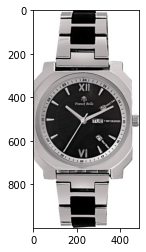

In [386]:
img = cv2.imread(df_data.iloc[18]['image_chemin'])
plt.imshow(img)
plt.show()

In [387]:
df_data.iloc[15]['image_chemin']

'C:/Users/Tewod/OneDrive/Bureau/Openclassrooms/projets/projet6/Flipkart/Images/1120bc768623572513df956172ffefeb.jpg'

## Ajout des categories

In [388]:
df_data["cat_1"] = df_data["product_category_tree"].str.split('>>').str[0].str[2:]
df_data["cat_2"] = df_data["product_category_tree"].str.split('>>').str[0].str[2:] + df_data["product_category_tree"].str.split('>>').str[1]
df_data["cat_3"] = df_data["product_category_tree"].str.split('>>').str[0].str[2:] + df_data["product_category_tree"].str.split('>>').str[1] + df_data["product_category_tree"].str.split('>>').str[2]

In [389]:
le = preprocessing.LabelEncoder()
df_data["label"] = le.fit_transform(df_data["cat_1"])
data = df_data[["image_chemin","cat_1","label"]]

In [390]:

# Renomer les categories
dict_cat = {'Baby Care ': 'baby','Beauty and Personal Care ': 'beauty', 'Computers ': 'computers',
            'Home Decor & Festive Needs ': 'decor', 'Home Furnishing ': 'home','Kitchen & Dining ': 'kitchen',
            'Watches ': 'watches'}

dict_code = dict(zip(dict_cat.keys(), range(0,7)))

In [391]:
df_data['product_category_code'] = df_data['cat_1'].map(dict_code)
df_data['product_category'] = df_data['cat_1'].map(dict_cat)

In [392]:
categories = list(dict_cat.values())

In [393]:
categories

['baby', 'beauty', 'computers', 'decor', 'home', 'kitchen', 'watches']

In [394]:
df_data['product_category_code'].value_counts()

4    150
0    150
6    150
3    150
5    150
1    150
2    150
Name: product_category_code, dtype: int64

In [395]:
list_labels = ['Home Furnishing ', 'Baby Care ', 'Watches ',
       'Home Decor & Festive Needs ', 'Kitchen & Dining ',
       'Beauty and Personal Care ', 'Computers ']

In [396]:
data.groupby("label").count()

,image_chemin,cat_1
label,,
0,150,150
1,150,150
2,150,150
3,150,150
4,150,150
5,150,150
6,150,150


In [397]:
data

,image_chemin,cat_1,label
0,C:/Users/Tewod/OneDrive/Bureau/Openclassrooms/...,Home Furnishing,4
1,C:/Users/Tewod/OneDrive/Bureau/Openclassrooms/...,Baby Care,0
2,C:/Users/Tewod/OneDrive/Bureau/Openclassrooms/...,Baby Care,0
3,C:/Users/Tewod/OneDrive/Bureau/Openclassrooms/...,Home Furnishing,4
4,C:/Users/Tewod/OneDrive/Bureau/Openclassrooms/...,Home Furnishing,4
...,...,...,...
1045,C:/Users/Tewod/OneDrive/Bureau/Openclassrooms/...,Baby Care,0
1046,C:/Users/Tewod/OneDrive/Bureau/Openclassrooms/...,Baby Care,0
1047,C:/Users/Tewod/OneDrive/Bureau/Openclassrooms/...,Baby Care,0
1048,C:/Users/Tewod/OneDrive/Bureau/Openclassrooms/...,Baby Care,0


## Afficher des exemples de photo

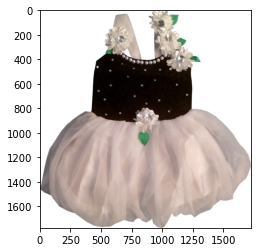

Baby Care 


In [398]:
r =  random.randrange(0, len(df_data) , 1)
img = cv2.imread(data.iloc[r]['image_chemin'])
plt.imshow(img)
plt.show()
print(data.iloc[r]['cat_1'])

## Taille des images

In [399]:
def get_image_ratio(img):
    filename = img
    image = cv2.imread(filename)
    ratio = round(image.shape[1]/image.shape[0],2)
    return ratio

In [400]:
data['image_ratio'] = data['image_chemin'].apply(get_image_ratio)

<ipython-input-400-3bbbc1200f28>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['image_ratio'] = data['image_chemin'].apply(get_image_ratio)


Text(0.5, 1.0, 'Distribution du ratio L*l image par catégorie')

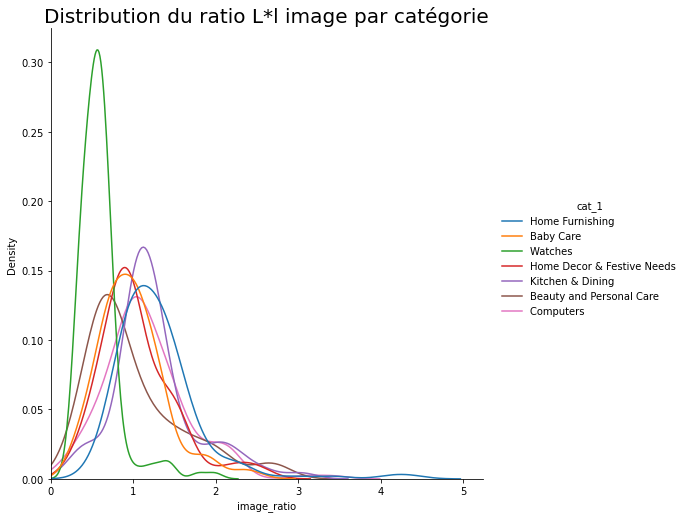

In [401]:
sns.displot( data = data , x = "image_ratio" , kind = 'kde', hue= "cat_1",height=7)
plt.xlim(0)
plt.title("Distribution du ratio L*l image par catégorie", size  = 20)

In [402]:
def get_image_defin(img):
    filename = img
    image = cv2.imread(filename)
    defin = image.shape[1]*image.shape[0]
    return defin

In [403]:
data['image_defin'] = data['image_chemin'].apply(get_image_defin)

<ipython-input-403-1c1e9df44852>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['image_defin'] = data['image_chemin'].apply(get_image_defin)


Text(0.5, 1.0, 'Distribution des definitions des images par catégorie')

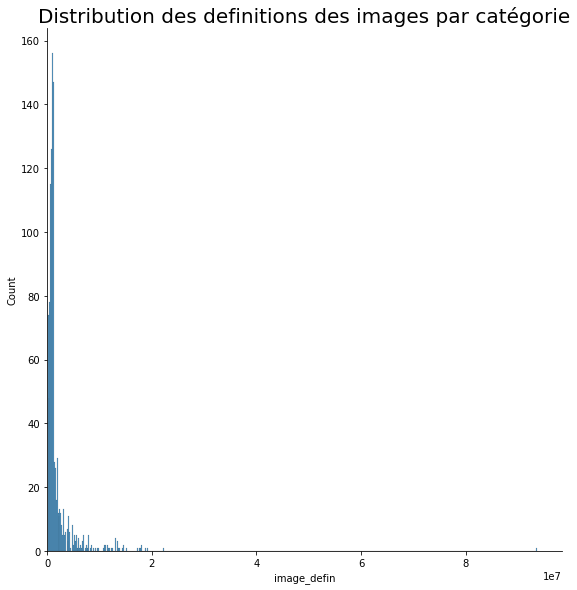

In [404]:
sns.displot( data = data , x = "image_defin" , kind = 'hist', height=8)
plt.xlim(0)
plt.title("Distribution des definitions des images par catégorie", size  = 20)

Text(0.5, 1.0, 'Distribution des definitions des images par catégorie')

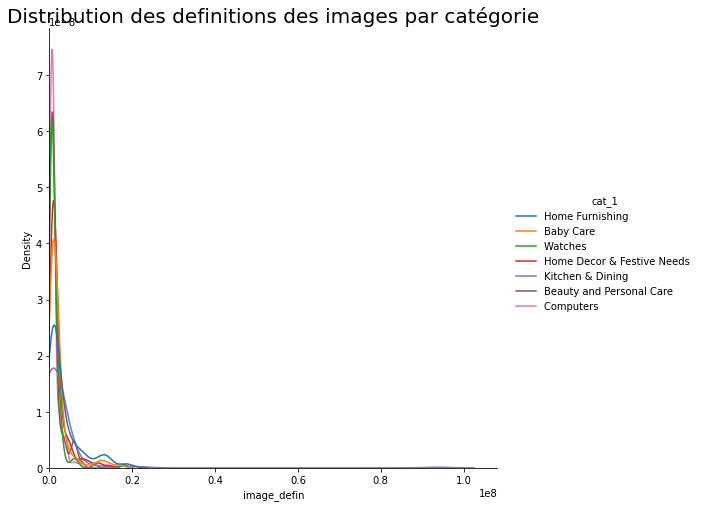

In [405]:
sns.displot( data = data , x = "image_defin" , kind = 'kde', hue= "cat_1",height=7)
plt.xlim(0)
plt.title("Distribution des definitions des images par catégorie", size  = 20)

## Pré-traitement des images

In [406]:
def resize_image(img, size=(250, 250)):
    '''function to resize image to 250 by 250 pixels with white background'''
    from skimage.transform import resize, pyramid_reduce
    h, w = img.shape[:2]
    c = img.shape[2] if len(img.shape) > 2 else 1

    if h == w:
        return cv2.resize(img, size, cv2.INTER_AREA)

    dif = h if h > w else w

    interpolation = cv2.INTER_AREA if dif > (
        size[0]+size[1])//2 else cv2.INTER_CUBIC

    x_pos = (dif - w)//2
    y_pos = (dif - h)//2

    if len(img.shape) == 2:
        mask = 255*np.ones((dif, dif), dtype=img.dtype)
        mask[y_pos:y_pos+h, x_pos:x_pos+w] = img[:h, :w]
    else:
        mask = 255*np.ones((dif, dif, c), dtype=img.dtype)
        mask[y_pos:y_pos+h, x_pos:x_pos+w, :] = img[:h, :w, :]

    return cv2.resize(mask, size, interpolation)

## Utilisation de SIFT

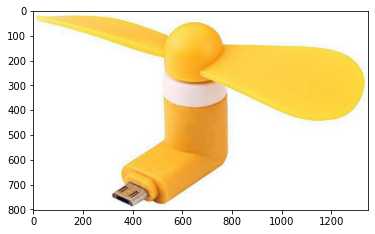

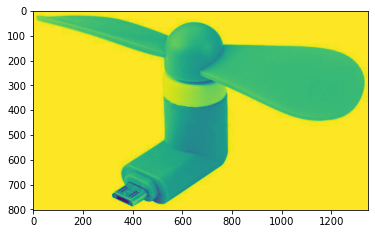

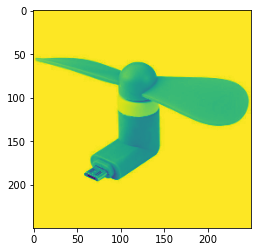

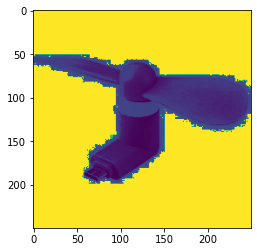

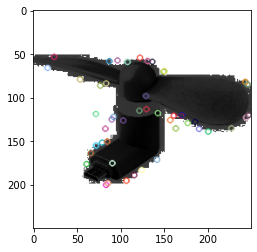

Descripteurs :  (66, 128)

[[  2.   0.   0. ...   0.   0.   0.]
 [  0.   0.   2. ...   0.   0.   1.]
 [ 26.   0.   0. ...   0.   0.   0.]
 ...
 [  0.  40. 147. ...   0.   0.   0.]
 [  3.   0.   0. ...   0.   0.   0.]
 [  6.   0.   0. ...   0.   0.   0.]]


In [407]:
sift = cv2.xfeatures2d.SIFT_create()
image = cv2.imread(data.iloc[53]['image_chemin'])
plt.imshow(image)
plt.show()
image = cv2.imread(data.iloc[53]['image_chemin'],0) # convertir en gris
plt.imshow(image)
plt.show()
image = resize_image(image, size=(250, 250)) # convertir en 250/250
plt.imshow(image)
plt.show()
image = cv2.equalizeHist(image)   # egaliser l'histogramme d'image 
plt.imshow(image)
plt.show()
kp, des = sift.detectAndCompute(image, None)
img=cv2.drawKeypoints(image,kp,image)
plt.imshow(img)
plt.show()
print("Descripteurs : ", des.shape)
print()
print(des)


## Fonction d'analyse des méthodes de segmentation

In [440]:
from sklearn.cluster import KMeans 
from sklearn.preprocessing import StandardScaler,  Normalizer ,RobustScaler
from sklearn.feature_extraction.text import CountVectorizer, TfidfTransformer, TfidfVectorizer
from sklearn import manifold, decomposition
from sklearn import metrics
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import FunctionTransformer
from sklearn.metrics import make_scorer
from sklearn.model_selection import GridSearchCV

In [441]:
pca = decomposition.PCA(n_components=0.99, svd_solver='full')
kmeans = KMeans(n_clusters=7, random_state=6, init='k-means++', n_init=10, max_iter=1000)

In [442]:
df_result_tot = pd.DataFrame(columns=['Model','ARI','kmeans silouette score','ARI_tsne5','ARI_tsne25','ARI_tsne50'])

In [443]:
def conf_mat_transform(conf_mat) :
    '''function to re-assign clusters by maximizing the diagonal of the confusion matrix'''

    # Inverse the number of items per categories (in order to use following function)
    conf_mat_temp = 1 /(conf_mat + 0.001)
    
    # apply function to get the combination of columns to minimize the diagonal 
    from scipy.optimize import linear_sum_assignment
    row_ind, col_ind = linear_sum_assignment(conf_mat_temp)

    # transform matrix according to new columns combination
    conf_mat_transform = conf_mat[:, col_ind]
    
    # reverse liste of column index
    corresp = col_ind.tolist()
    
    return corresp, conf_mat_transform

In [462]:
def analyse(X,name):

  df_result = pd.DataFrame(columns=['Model','ARI','kmeans silouette score','ARI_tsne5','ARI_tsne25','ARI_tsne50'])
  kmeans = KMeans(n_clusters=7, random_state=6, init='k-means++', n_init=10, max_iter=1000)
  X_kmean = kmeans.fit_transform(X)
  y_pred = pd.Series(kmeans.labels_)

  y_true = data['label']

  tsne5 = manifold.TSNE(n_components=2,perplexity=5 , n_iter=1000, init='random', random_state=6)
  X_tsne5 = tsne5.fit_transform(X)
  X_kmean_tsne5 = kmeans.fit_transform(X_tsne5)
  y_pred_tsne5 = pd.Series(kmeans.labels_)
  df_tsne5 = pd.DataFrame(X_tsne5[:,0:2], columns=['tsne1', 'tsne2'])
  df_tsne5["class"] = data["cat_1"]

  df_tsne5["kmeans"] = y_pred
  df_tsne5["kmeans_tsne5"] = y_pred_tsne5

  tsne25 = manifold.TSNE(n_components=2,perplexity=25 , n_iter=1000, init='random', random_state=6)
  X_tsne25 = tsne25.fit_transform(X)
  X_kmean_tsne25 = kmeans.fit_transform(X_tsne25)
  y_pred_tsne25 = pd.Series(kmeans.labels_)
  df_tsne25 = pd.DataFrame(X_tsne25[:,0:2], columns=['tsne1', 'tsne2'])
  df_tsne25["class"] = data["cat_1"]

  df_tsne25["kmeans"] = y_pred
  df_tsne25["kmeans_tsne25"] = y_pred_tsne25

  tsne50 = manifold.TSNE(n_components=2, perplexity=50 , n_iter=1000, init='random', random_state=6)
  X_tsne50 = tsne50.fit_transform(X)
  X_kmean_tsne50 = kmeans.fit_transform(X_tsne50)
  y_pred_tsne50 = pd.Series(kmeans.labels_)
  df_tsne50 = pd.DataFrame(X_tsne50[:,0:2], columns=['tsne1', 'tsne2'])
  df_tsne50["class"] = data["cat_1"]

  df_tsne50["kmeans"] = y_pred
  df_tsne50["kmeans_tsne50"] = y_pred_tsne50

  #tsne5
  plt.figure(figsize=(15,8))
  sns.scatterplot(
      x="tsne1", y="tsne2", hue="class", data=df_tsne5, legend="brief",
      palette=sns.color_palette('tab10', n_colors=7), s=50, alpha=0.6)

  plt.title('TSNE 5 selon les vraies classes', fontsize = 15, pad = 35, fontweight = 'bold')
  plt.xlabel('tsne1', fontsize = 15, fontweight = 'bold')
  plt.ylabel('tsne2', fontsize = 15, fontweight = 'bold')
  plt.legend(prop={'size': 10}) 

  plt.show()

  #tsne5_ kmeans
  plt.figure(figsize=(15,8))
  sns.scatterplot(
      x="tsne1", y="tsne2", hue="kmeans", data=df_tsne5, legend="brief",
      palette=sns.color_palette('tab10',n_colors=7), s=50, alpha=0.6)

  plt.title('TSNE 5 selon kmeans', fontsize = 15, pad = 35, fontweight = 'bold')
  plt.xlabel('tsne1', fontsize = 15, fontweight = 'bold')
  plt.ylabel('tsne2', fontsize = 15, fontweight = 'bold')
  plt.legend(prop={'size': 10}) 

  plt.show()

    #tsne5_kmeans_tsne5
  plt.figure(figsize=(15,8))
  sns.scatterplot(
      x="tsne1", y="tsne2", hue="kmeans_tsne5", data=df_tsne5, legend="brief",
      palette=sns.color_palette('tab10',n_colors=7), s=50, alpha=0.6)

  plt.title('TSNE 5 selon kmeans sur tsne', fontsize = 15, pad = 35, fontweight = 'bold')
  plt.xlabel('tsne1', fontsize = 15, fontweight = 'bold')
  plt.ylabel('tsne2', fontsize = 15, fontweight = 'bold')
  plt.legend(prop={'size': 10}) 

  plt.show()

  #tsne25
  plt.figure(figsize=(15,8))
  sns.scatterplot(
      x="tsne1", y="tsne2", hue="class", data=df_tsne25, legend="brief",
      palette=sns.color_palette('tab10',n_colors=7), s=50, alpha=0.6)

  plt.title('TSNE 25 selon les vraies classes', fontsize = 15, pad = 35, fontweight = 'bold')
  plt.xlabel('tsne1', fontsize = 15, fontweight = 'bold')
  plt.ylabel('tsne2', fontsize = 15, fontweight = 'bold')
  plt.legend(prop={'size': 10}) 

  plt.show()

  plt.figure(figsize=(15,8))
  sns.scatterplot(
      x="tsne1", y="tsne2", hue="kmeans", data=df_tsne25, legend="brief",
      palette=sns.color_palette('tab10',n_colors=7), s=50, alpha=0.6)

  plt.title('TSNE 25 selon kmeans', fontsize = 15, pad = 35, fontweight = 'bold')
  plt.xlabel('tsne1', fontsize = 15, fontweight = 'bold')
  plt.ylabel('tsne2', fontsize = 15, fontweight = 'bold')
  plt.legend(prop={'size': 10}) 

  plt.show()

  plt.figure(figsize=(15,8))
  sns.scatterplot(
      x="tsne1", y="tsne2", hue="kmeans_tsne25", data=df_tsne25, legend="brief",
      palette=sns.color_palette('tab10',n_colors=7), s=50, alpha=0.6)

  plt.title('TSNE 25 selon kmeans sur tsne', fontsize = 15, pad = 35, fontweight = 'bold')
  plt.xlabel('tsne1', fontsize = 15, fontweight = 'bold')
  plt.ylabel('tsne2', fontsize = 15, fontweight = 'bold')
  plt.legend(prop={'size': 10}) 

  plt.show()

  #tsne50
  plt.figure(figsize=(15,8))
  sns.scatterplot(
      x="tsne1", y="tsne2", hue="class", data=df_tsne50, legend="brief",
      palette=sns.color_palette('tab10', n_colors=7), s=50, alpha=0.6)

  plt.title('TSNE 50 selon les vraies classes', fontsize = 15, pad = 35, fontweight = 'bold')
  plt.xlabel('tsne1', fontsize = 15, fontweight = 'bold')
  plt.ylabel('tsne2', fontsize = 15, fontweight = 'bold')
  plt.legend(prop={'size': 10}) 

  plt.show()


  plt.figure(figsize=(15,8))
  sns.scatterplot(
      x="tsne1", y="tsne2", hue="kmeans", data=df_tsne50, legend="brief",
      palette=sns.color_palette('tab10',n_colors=7), s=50, alpha=0.6)

  plt.title('TSNE 50 selon kmeans', fontsize = 15, pad = 35, fontweight = 'bold')
  plt.xlabel('tsne1', fontsize = 15, fontweight = 'bold')
  plt.ylabel('tsne2', fontsize = 15, fontweight = 'bold')
  plt.legend(prop={'size': 10}) 

  plt.show()
        
    
  plt.figure(figsize=(15,8))
  sns.scatterplot(
      x="tsne1", y="tsne2", hue="kmeans_tsne50", data=df_tsne50, legend="brief",
      palette=sns.color_palette('tab10',n_colors=7), s=50, alpha=0.6)

  plt.title('TSNE 50 selon kmeans sur tsne', fontsize = 15, pad = 35, fontweight = 'bold')
  plt.xlabel('tsne1', fontsize = 15, fontweight = 'bold')
  plt.ylabel('tsne2', fontsize = 15, fontweight = 'bold')
  plt.legend(prop={'size': 10}) 

  plt.show()

   
    
  # matrice
  conf_mat = metrics.confusion_matrix(y_true, y_pred)
  corresp, conf_mat = conf_mat_transform(conf_mat) 

  dict_clusters = dict(zip(corresp, range(0,7)))
  y_pred_transform = y_pred.map(dict_clusters)

  df_cm = pd.DataFrame(conf_mat, index = categories, columns = range(0,7))
  plt.figure(figsize = (8,8))
  plt.title('matrice kmeans', fontsize = 15, pad = 35, fontweight = 'bold')
  sns.heatmap(df_cm, annot=True, cmap="Pastel1_r", fmt='g' )
  plt.show()

  # matrice tsne5
  conf_mat = metrics.confusion_matrix(y_true, y_pred_tsne5)
  corresp, conf_mat = conf_mat_transform(conf_mat) 

  dict_clusters = dict(zip(corresp, range(0,7)))
  y_pred_transform = y_pred.map(dict_clusters)

  df_cm = pd.DataFrame(conf_mat, index = categories, columns = range(0,7))
  plt.figure(figsize = (8,8))
  plt.title('matrice kmeans sur tsne5', fontsize = 15, pad = 35, fontweight = 'bold')
  sns.heatmap(df_cm, annot=True, cmap="Pastel1_r", fmt='g' )
  plt.show()

  # matrice tsne25
  conf_mat = metrics.confusion_matrix(y_true, y_pred_tsne25)
  corresp, conf_mat = conf_mat_transform(conf_mat) 

  dict_clusters = dict(zip(corresp, range(0,7)))
  y_pred_transform = y_pred.map(dict_clusters)

  df_cm = pd.DataFrame(conf_mat, index = categories, columns = range(0,7))
  plt.figure(figsize = (8,8))
  plt.title('matrice kmeans sur tsne25', fontsize = 15, pad = 35, fontweight = 'bold')
  sns.heatmap(df_cm, annot=True, cmap="Pastel1_r", fmt='g' )
  plt.show()

  # matrice tsne50
  conf_mat = metrics.confusion_matrix(y_true, y_pred_tsne50)
  corresp, conf_mat = conf_mat_transform(conf_mat) 

  dict_clusters = dict(zip(corresp, range(0,7)))
  y_pred_transform = y_pred.map(dict_clusters)

  df_cm = pd.DataFrame(conf_mat, index = categories, columns = range(0,7))
  plt.figure(figsize = (8,8))
  plt.title('matrice kmeans sur tsne50', fontsize = 15, pad = 35, fontweight = 'bold')
  sns.heatmap(df_cm, annot=True, cmap="Pastel1_r", fmt='g' )
  plt.show()

  # score
  sil = metrics.silhouette_score(X , kmeans.labels_)
  print("silhouette score : " , sil)
  ari = metrics.adjusted_rand_score(y_true, y_pred)
  print("ARi score : ", ari)
  ari_tsne5 = metrics.adjusted_rand_score(y_true, y_pred_tsne5)
  print("ARi score tsne5 : ", ari_tsne5)
  ari_tsne25 = metrics.adjusted_rand_score(y_true, y_pred_tsne25)
  print("ARi score tsne25 : ", ari_tsne25)
  ari_tsne50 = metrics.adjusted_rand_score(y_true, y_pred_tsne50)
  print("ARi score tsne50 : ", ari_tsne50)

  df_result=df_result.append({'Model' : name , 'ARI' : ari , 'kmeans silouette score' : sil ,'ARI_tsne5': ari_tsne5 ,'ARI_tsne25' : ari_tsne25,'ARI_tsne50':ari_tsne50 } , ignore_index=True)
  return df_result

In [463]:
def best_reduc_svd(X):
  n_dims = (X.shape[1] -1)
  model = decomposition.TruncatedSVD(n_components = n_dims)
  model.fit(X)

  variances = model.explained_variance_ratio_
  meilleur_dims = np.argmax(np.cumsum(variances) > 0.99) 

  print("Dimensions dataset avant réduction svd : ", X.shape)
  model = decomposition.TruncatedSVD(n_components = meilleur_dims)
  X_reduc = model.fit_transform(X)
  print("variance après réduction svd : ", model.explained_variance_ratio_.sum())
  print("Dimensions dataset après réduction svd : ", X_reduc.shape)
  return X_reduc

## Utilisation de SIFT

## Créations des descripteurs de chaque image
- Pour chaque image passage en gris et equalisation
- Redimensionnement en 250/250
- création d'une liste de descripteurs par image ("sift_keypoints_by_img") qui sera utilisée pour réaliser les histogrammes par image
- création d'une liste de descripteurs pour l'ensemble des images ("sift_keypoints_all") qui sera utilisé pour créer les clusters de descripteurs

In [455]:
list_photos = data['image_chemin']

In [456]:
len(list_photos)

1050

In [457]:
# identification of key points and associated descriptors
import time, cv2
sift_keypoints = []
temps1=time.time()
sift = cv2.xfeatures2d.SIFT_create(500)

for image_num in range(len(list_photos)) :
    if image_num%100 == 0 : print(image_num)
    image = cv2.imread(list_photos[image_num],0) # convert in gray
    image = resize_image(image, size=(250, 250))
    res = cv2.equalizeHist(image)   # equalize image histogram
    kp, des = sift.detectAndCompute(res, None)
    sift_keypoints.append(des)

sift_keypoints_by_img = np.asarray(sift_keypoints)
sift_keypoints_all    = np.concatenate(sift_keypoints_by_img, axis=0)

print()
print("Nombre de descripteurs : ", sift_keypoints_all.shape)

duration1=time.time()-temps1
print("temps de traitement SIFT descriptor : ", "%15.2f" % duration1, "secondes")

0
100
200
300
400
500
600
700
800
900
1000


<ipython-input-457-b05d9f4d3b9b>:15: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  sift_keypoints_by_img = np.asarray(sift_keypoints)



Nombre de descripteurs :  (257313, 128)
temps de traitement SIFT descriptor :            38.55 secondes


## Création des clusters de descripteurs
* Utilisation de MiniBatchKMeans pour obtenir des temps de traitement raisonnables

In [458]:
# Détermination number of clusters
temps1=time.time()

k = int(round(np.sqrt(len(sift_keypoints_all)),0))
print("Nombre de clusters estimés : ", k)
print("Création de",k, "clusters de descripteurs ...")

# Clustering
kmeans = cluster.MiniBatchKMeans(n_clusters=k, init_size=3*k, random_state=0)
kmeans.fit(sift_keypoints_all)

duration1=time.time()-temps1
print("temps de traitement kmeans : ", "%15.2f" % duration1, "secondes")

Nombre de clusters estimés :  507
Création de 507 clusters de descripteurs ...
temps de traitement kmeans :            36.42 secondes


## Création des features des images
* Pour chaque image : 
   - prédiction des numéros de cluster de chaque descripteur
   - création d'un histogramme = comptage pour chaque numéro de cluster du nombre de descripteurs de l'image

Features d'une image = Histogramme d'une image = Comptage pour une image du nombre de descripteurs par cluster

In [459]:
# Création d'histogrammes (features)
temps1=time.time()

def build_histogram(kmeans, des, image_num):
    res = kmeans.predict(des)
    hist = np.zeros(len(kmeans.cluster_centers_))
    nb_des=len(des)
    if nb_des==0 : print("problème histogramme image  : ", image_num)
    for i in res:
        hist[i] += 1.0/nb_des
    return hist


# Création de matrice d'histogrammes
hist_vectors=[]

for i, image_desc in enumerate(sift_keypoints_by_img) :
    if i%100 == 0 : print(i)  
    hist = build_histogram(kmeans, image_desc, i) #calculates the histogram
    hist_vectors.append(hist) #histogram is the feature vector

im_features = np.asarray(hist_vectors)

duration1=time.time()-temps1
print("temps de création histogrammes : ", "%15.2f" % duration1, "secondes")


0
100
200
300
400
500
600
700
800
900
1000
temps de création histogrammes :             3.40 secondes


## Réductions de dimension

### Réduction de dimension PCA
* La réduction PCA permet de créer des features décorrélées entre elles, et de diminuer leur dimension, tout en gardant un niveau de variance expliquée élevé (99%)
* L'impact est une meilleure séparation des données via le T-SNE et une réduction du temps de traitement du T-SNE

In [460]:
from sklearn import manifold, decomposition

print("Dimensions dataset avant réduction PCA : ", im_features.shape)
pca = decomposition.PCA(n_components=0.99)
feat_pca= pca.fit_transform(im_features)
print("Dimensions dataset après réduction PCA : ", feat_pca.shape)

Dimensions dataset avant réduction PCA :  (1050, 507)
Dimensions dataset après réduction PCA :  (1050, 420)


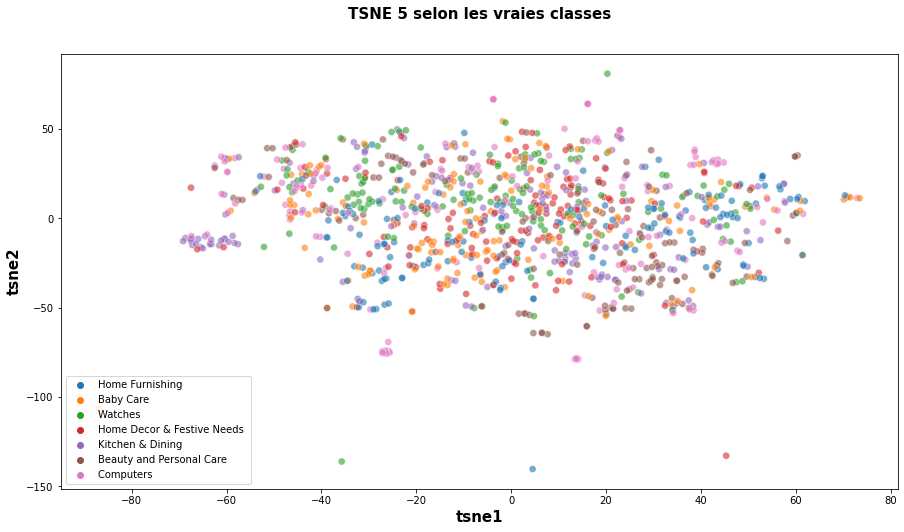

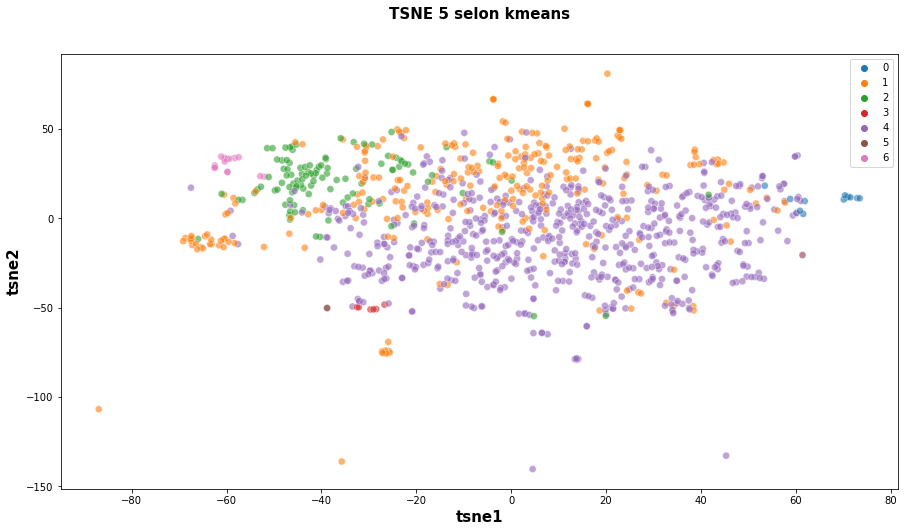

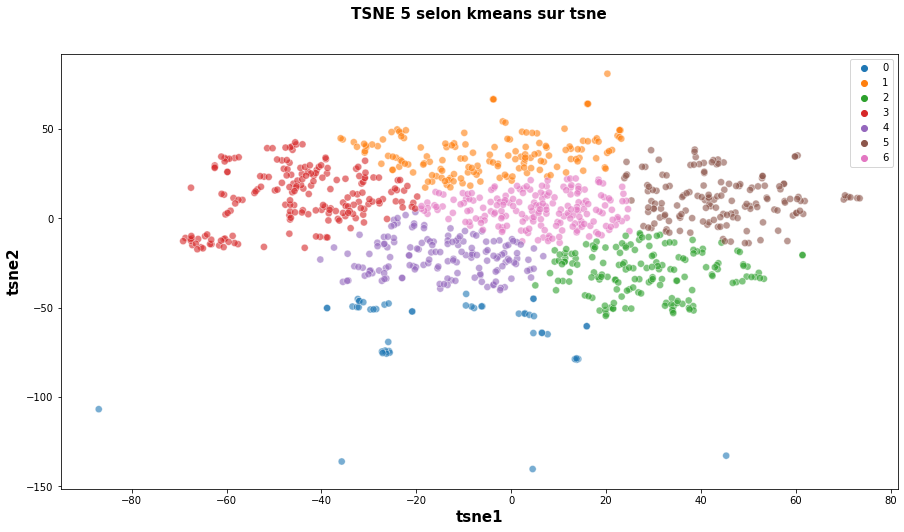

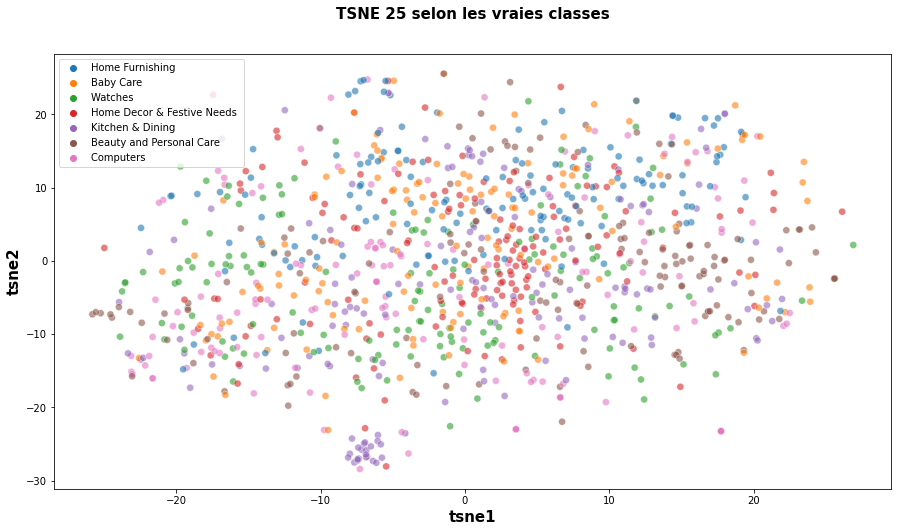

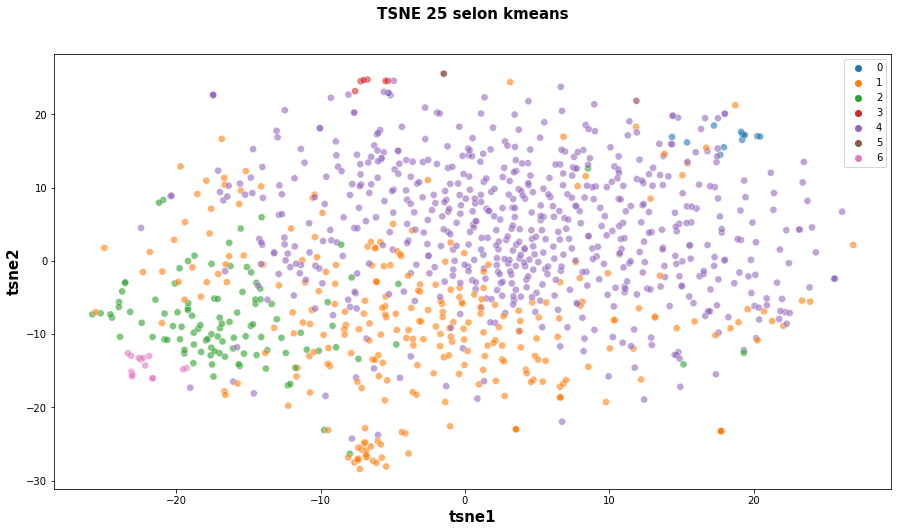

...

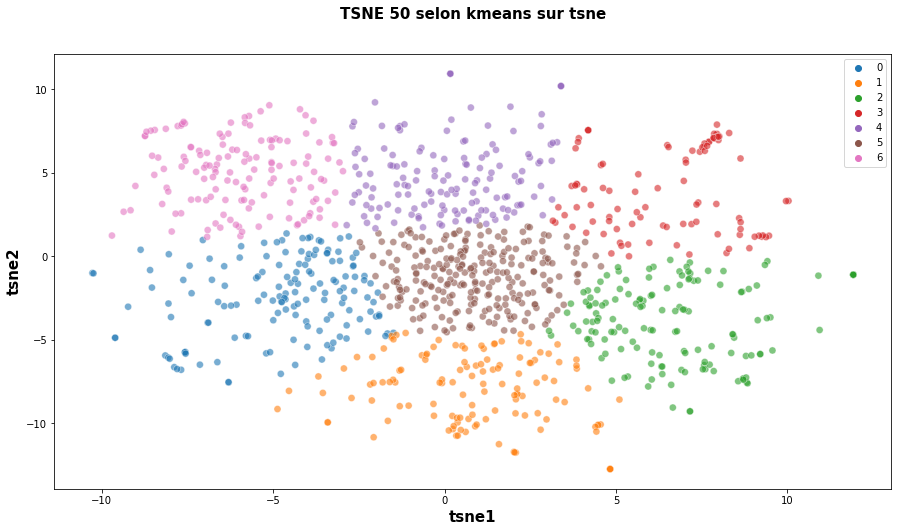

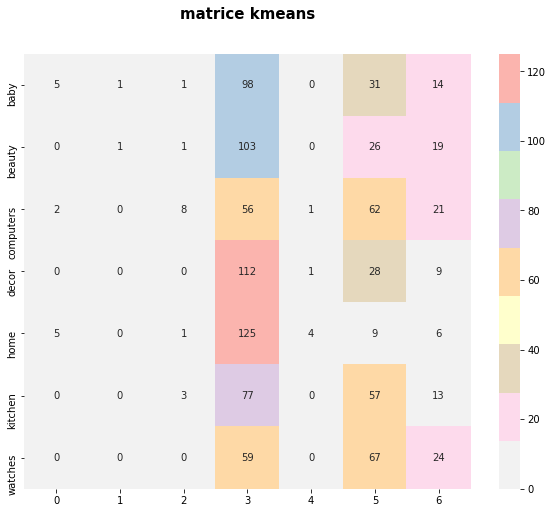

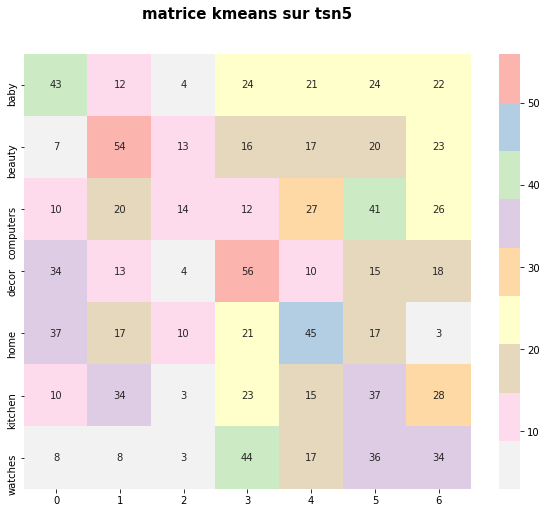

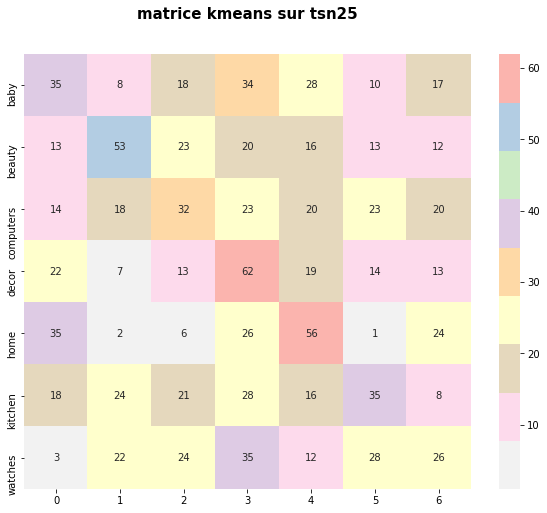

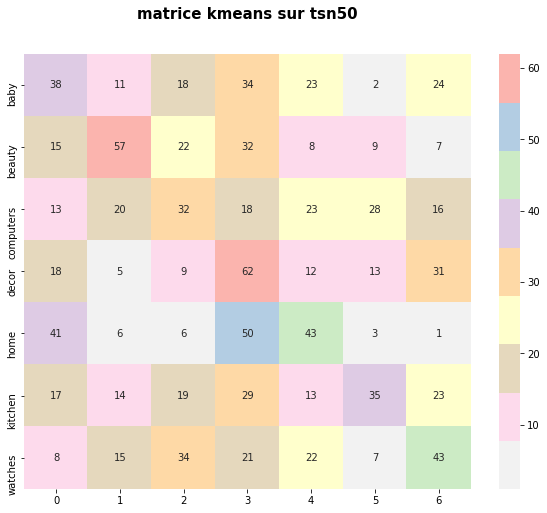

silhouette score :  -0.05915274191288221
ARi score :  0.027601415720974184
ARi score tsne5 :  0.04349350317369202
ARi score tsne25 :  0.042533426996427114
ARi score tsne50 :  0.05247925488545013


In [461]:
result = (analyse(feat_pca,"sift"))
df_result_tot = df_result_tot.append(result)

# Utilisation de ORB

In [464]:
list_photos = data['image_chemin']

In [465]:
len(list_photos)

1050

In [466]:
# identification of key points and associated descriptors
import time, cv2
orb_keypoints = []
temps1=time.time()
orb = cv2.ORB_create(500)

for image_num in range(len(list_photos)) :
    if image_num%100 == 0 : print(image_num)
    image = cv2.imread(list_photos[image_num],0) # convert in gray
    image = resize_image(image, size=(250, 250))
    res = cv2.equalizeHist(image)   # equalize image histogram
    kp, des = orb.detectAndCompute(res, None)
    orb_keypoints.append(des)

orb_keypoints_by_img = np.asarray(orb_keypoints)
orb_keypoints_all    = np.concatenate(orb_keypoints_by_img, axis=0)

print()
print("Nombre de descripteurs : ", orb_keypoints_all.shape)

duration1=time.time()-temps1
print("temps de traitement orb descriptor : ", "%15.2f" % duration1, "secondes")

0
100
200
300
400
500
600
700
800
900
1000

Nombre de descripteurs :  (407294, 32)
temps de traitement orb descriptor :            19.56 secondes


<ipython-input-466-6830bfa9a1f0>:15: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  orb_keypoints_by_img = np.asarray(orb_keypoints)


## Création des clusters de descripteurs
* Utilisation de MiniBatchKMeans pour obtenir des temps de traitement raisonnables

In [467]:

# Determination number of clusters
temps1=time.time()

k = int(round(np.sqrt(len(orb_keypoints_all)),0))
print("Nombre de clusters estimés : ", k)
print("Création de",k, "clusters de descripteurs ...")

# Clustering
kmeans = cluster.MiniBatchKMeans(n_clusters=k, init_size=3*k, random_state=0)
kmeans.fit(orb_keypoints_all)

duration1=time.time()-temps1
print("temps de traitement kmeans : ", "%15.2f" % duration1, "secondes")

Nombre de clusters estimés :  638
Création de 638 clusters de descripteurs ...
temps de traitement kmeans :             4.70 secondes


## Création des features des images
* Pour chaque image : 
   - prédiction des numéros de cluster de chaque descripteur
   - création d'un histogramme = comptage pour chaque numéro de cluster du nombre de descripteurs de l'image

Features d'une image = Histogramme d'une image = Comptage pour une image du nombre de descripteurs par cluster

In [468]:
# Creation of histograms (features)
temps1=time.time()

def build_histogram(kmeans, des, image_num):
    res = kmeans.predict(des)
    hist = np.zeros(len(kmeans.cluster_centers_))
    nb_des=len(des)
    if nb_des==0 : print("problème histogramme image  : ", image_num)
    for i in res:
        hist[i] += 1.0/nb_des
    return hist


# Creation of a matrix of histograms
hist_vectors=[]

for i, image_desc in enumerate(orb_keypoints_by_img) :
    if i%100 == 0 : print(i)  
    hist = build_histogram(kmeans, image_desc, i) #calculates the histogram
    hist_vectors.append(hist) #histogram is the feature vector

im_features = np.asarray(hist_vectors)

duration1=time.time()-temps1
print("temps de création histogrammes : ", "%15.2f" % duration1, "secondes")


0
100
200
300
400
500
600
700
800
900
1000
temps de création histogrammes :             4.19 secondes


## Réductions de dimension

### Réduction de dimension PCA
* La réduction PCA permet de créer des features décorrélées entre elles, et de diminuer leur dimension, tout en gardant un niveau de variance expliquée élevé (99%)
* L'impact est une meilleure séparation des données via le T-SNE et une réduction du temps de traitement du T-SNE

In [469]:
from sklearn import manifold, decomposition

print("Dimensions dataset avant réduction PCA : ", im_features.shape)
pca = decomposition.PCA(n_components=0.99)
feat_pca= pca.fit_transform(im_features)
print("Dimensions dataset après réduction PCA : ", feat_pca.shape)

Dimensions dataset avant réduction PCA :  (1050, 638)
Dimensions dataset après réduction PCA :  (1050, 367)


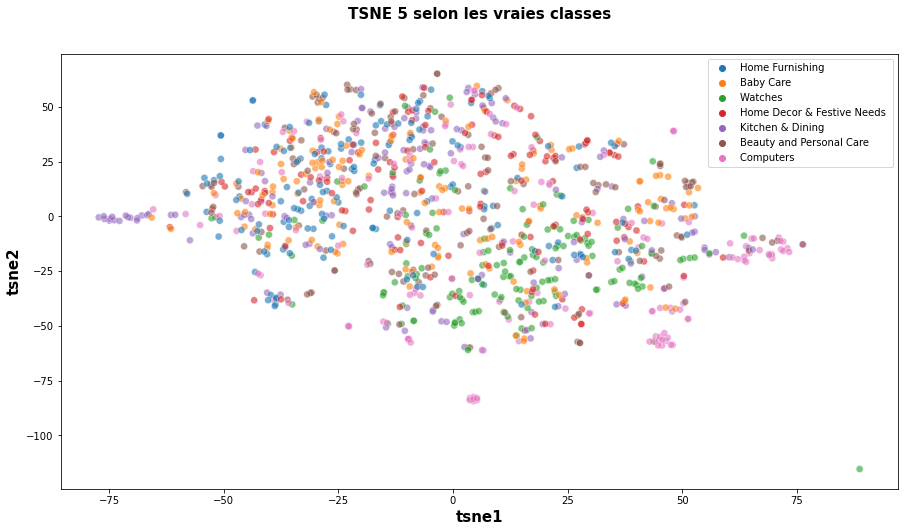

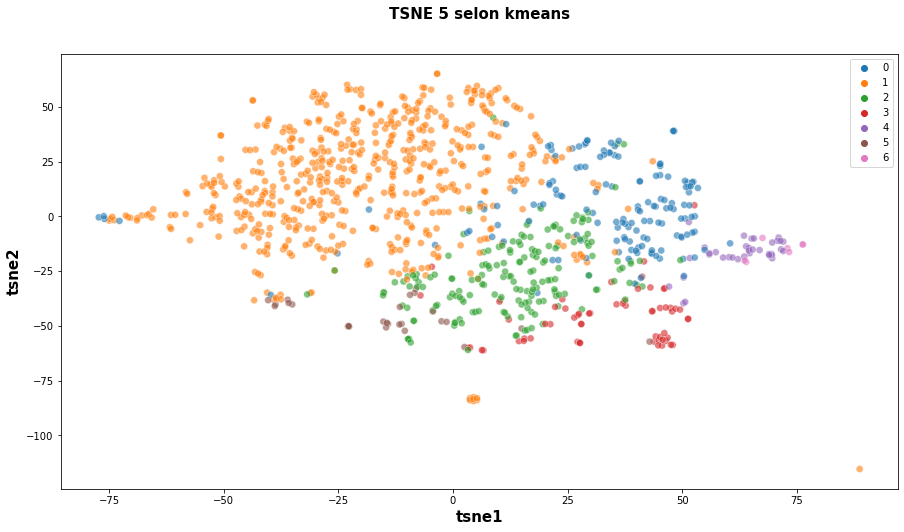

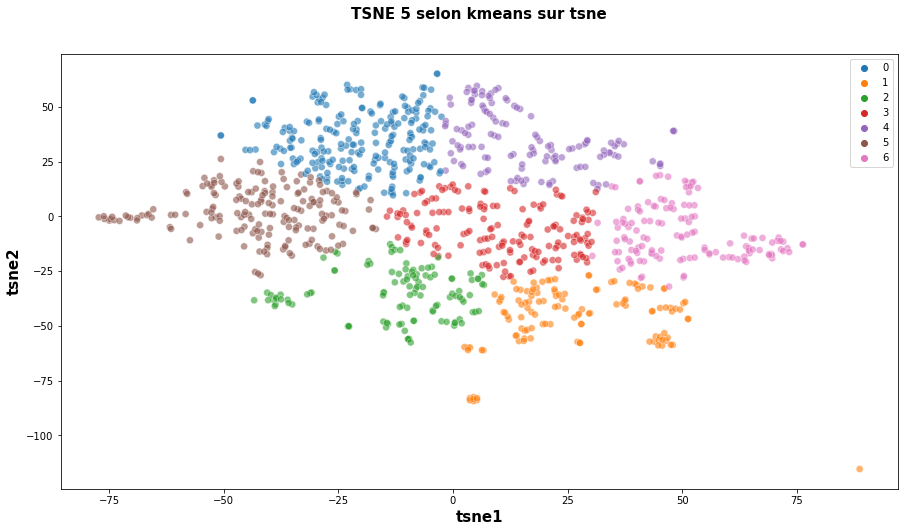

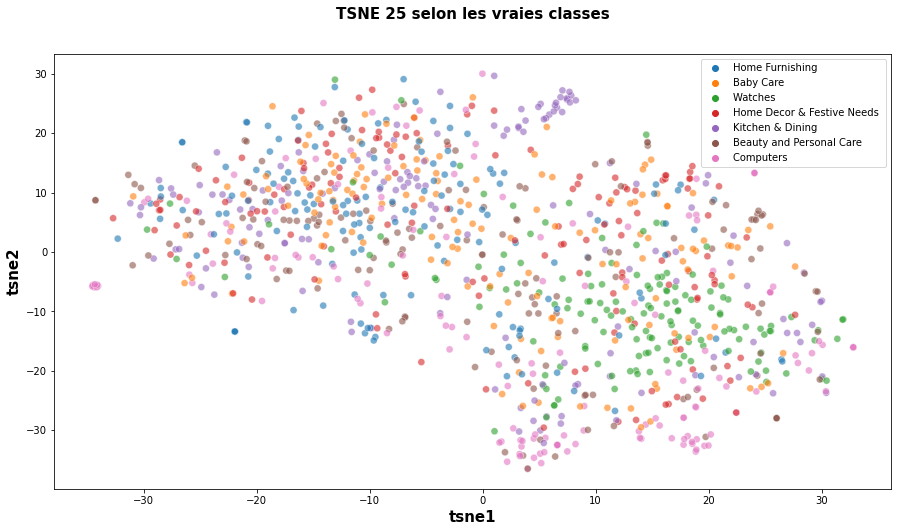

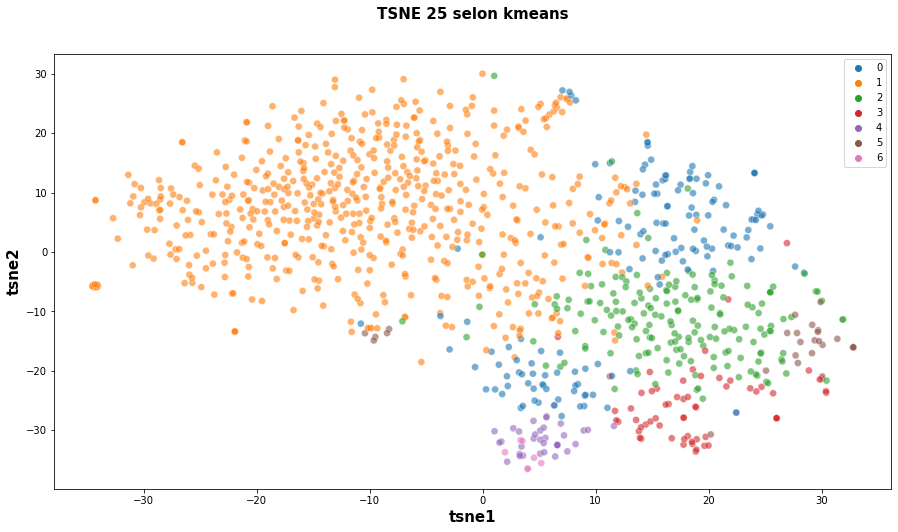

...

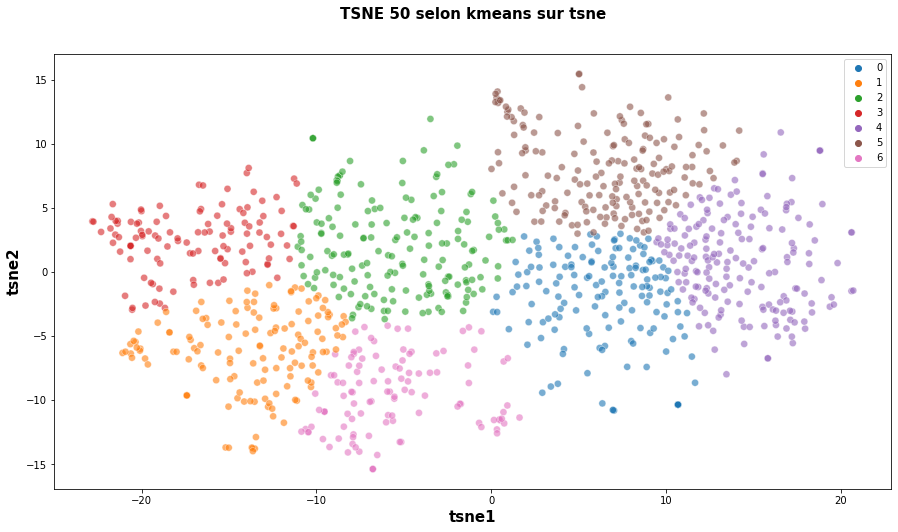

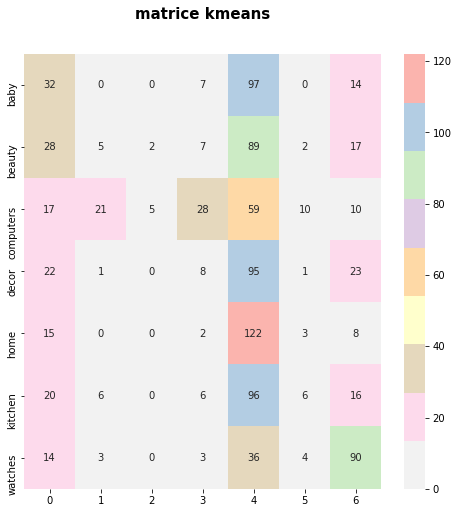

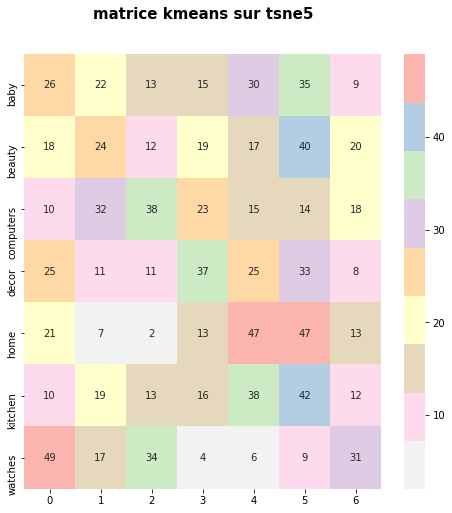

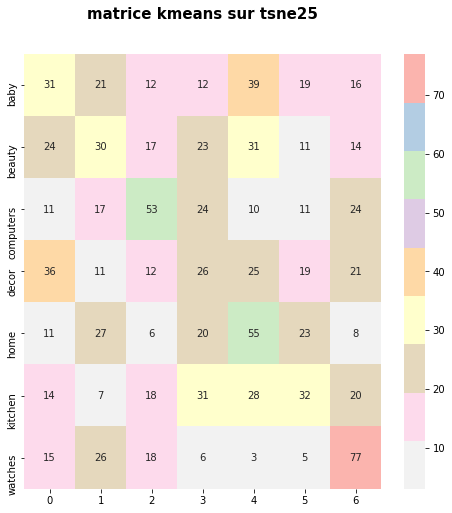

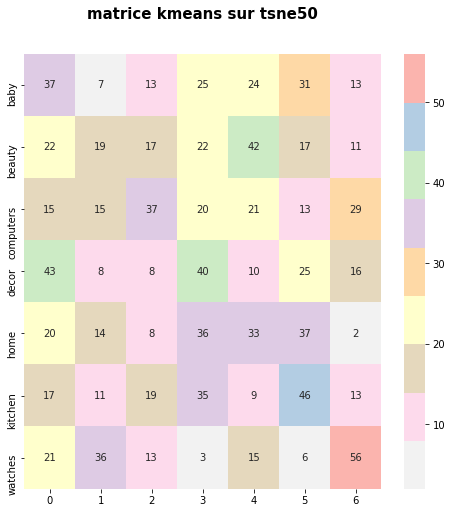

silhouette score :  -0.01214271027920498
ARi score :  0.04625385802653526
ARi score tsne5 :  0.03789039789618247
ARi score tsne25 :  0.0567131616056943
ARi score tsne50 :  0.04428569971372202


In [470]:
result = (analyse(feat_pca,"orb"))
df_result_tot = df_result_tot.append(result)

# Transfer learning

In [471]:
from keras.models import Sequential

my_VGG16 = Sequential()  # Création d'un réseau de neurones vide 

In [472]:
from keras.applications.vgg16 import VGG16

model = VGG16() # Création du modèle VGG-16 implementé par Keras

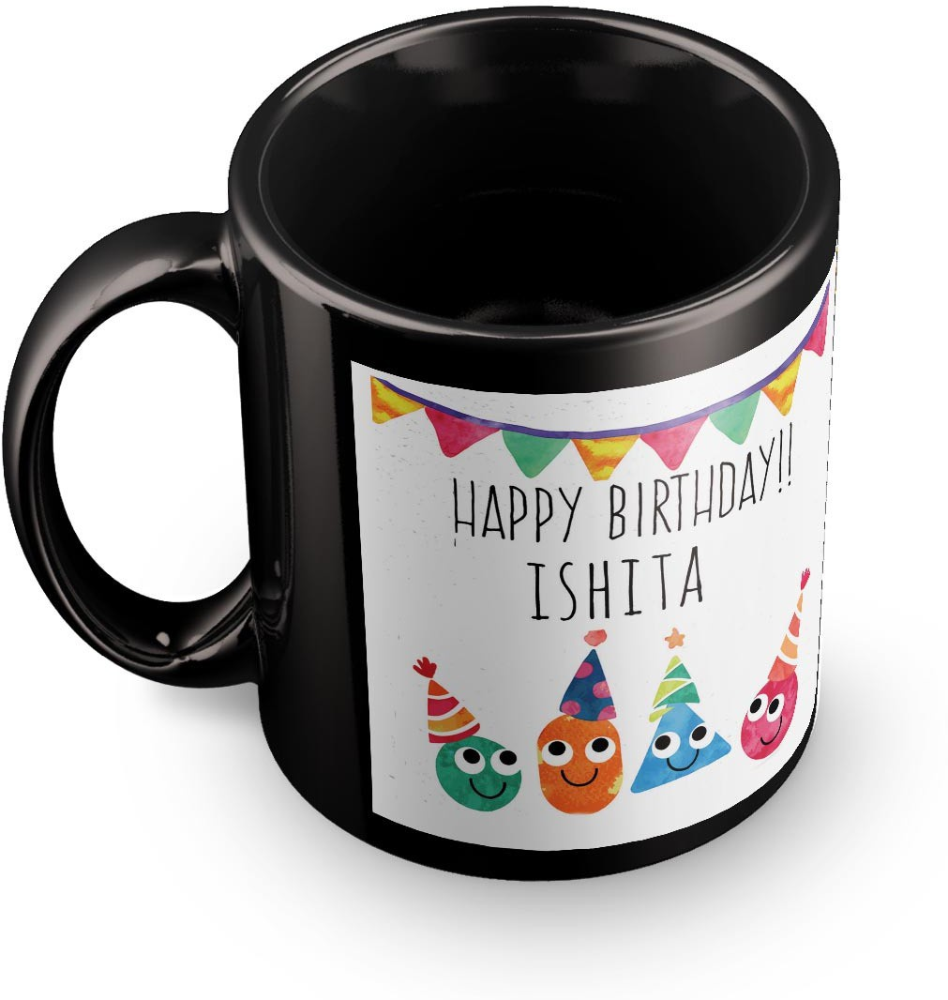

In [473]:
Image('C:/Users/Tewod/OneDrive/Bureau/Openclassrooms/projets/projet6/Flipkart/Images/5e52d6ce133e5307814f9f3eedc5806d.jpg', width=150)

In [474]:
from keras.preprocessing.image import load_img, img_to_array
from keras.applications.vgg16 import preprocess_input

img = load_img('C:/Users/Tewod/OneDrive/Bureau/Openclassrooms/projets/projet6/Flipkart/Images/1120bc768623572513df956172ffefeb.jpg', target_size=(224, 224))  # Charger l'image
img = img_to_array(img)  # Convertir en tableau numpy
img = img.reshape((1, img.shape[0], img.shape[1], img.shape[2]))  # Créer la collection d'images (un seul échantillon)
img = preprocess_input(img)  # Prétraiter l'image comme le veut VGG-16


In [475]:
y = model.predict(img)  # Prédir la classe de l'image (parmi les 1000 classes d'ImageNet)

In [476]:
from keras.applications.vgg16 import decode_predictions

# Afficher les 3 classes les plus probables
print('Top 3 :', decode_predictions(y, top=3)[0])

Top 3 : [('n03706229', 'magnetic_compass', 0.6985369), ('n02794156', 'barometer', 0.13723193), ('n02708093', 'analog_clock', 0.13549455)]


## Utilisation de VGG16 "brut"

In [477]:
# identification des points clés et des descripteurs associés

import time, cv2
vgg_keypoints = []
temps1=time.time()

for image_num in range(len(list_photos)) :
    if image_num%100 == 0 : print(image_num)
    image = load_img(list_photos[image_num], target_size=(224, 224))  # Charger l'image
    image = img_to_array(image)  # Convertir en tableau numpy
    image = img.reshape((1, image.shape[0], image.shape[1], image.shape[2]))  # Créer la collection d'images (un seul échantillon)
    image = preprocess_input(image)

    des = model.predict(image).reshape(-1)
    vgg_keypoints.append(des)

img_feat = pd.Series(vgg_keypoints)

duration1=time.time()-temps1
print("temps de traitement vgg descriptor : ", "%15.2f" % duration1, "secondes")

0
100
200
300
400
500
600
700
800
900
1000
temps de traitement vgg descriptor :           494.54 secondes


In [478]:
X_df = pd.DataFrame.from_dict(dict(zip(img_feat.index, img_feat.values))).T
X_df.shape

(1050, 1000)

In [479]:
X_df

,0,1,2,3,4,5,6,7,8,9,...,990,991,992,993,994,995,996,997,998,999
0,1.900217e-12,6.187759e-12,8.331635e-13,6.124888e-13,5.208251e-12,5.360312e-12,9.536738e-13,1.060556e-11,1.260655e-11,4.805484e-12,...,1.126392e-10,7.377401e-11,2.604278e-12,1.706150e-12,8.065281e-12,1.391334e-09,2.419643e-11,8.208918e-12,5.373189e-12,7.463624e-11
1,5.151587e-16,2.583060e-15,1.154973e-16,1.139777e-16,1.357211e-15,9.600962e-16,8.463286e-17,3.169846e-15,5.106939e-15,1.200937e-15,...,4.599915e-14,2.238133e-14,3.315081e-16,2.849614e-16,2.783148e-15,2.019466e-12,5.496048e-15,1.576892e-15,1.738901e-15,1.481150e-14
2,6.596555e-20,5.656257e-19,4.783307e-21,6.295699e-21,1.546553e-19,7.916727e-20,3.810415e-21,5.105365e-19,1.044253e-18,1.558802e-19,...,8.146040e-18,4.450570e-18,1.580367e-20,2.238184e-20,6.186666e-19,1.714796e-15,7.342085e-19,1.111763e-19,2.113105e-19,3.965159e-18
3,1.295670e-23,1.744560e-22,3.182742e-25,5.761772e-25,2.746148e-23,1.093443e-23,2.545501e-25,1.405488e-22,2.922547e-22,3.353912e-23,...,2.039832e-21,1.433718e-21,1.004134e-24,2.339853e-24,2.379914e-22,2.236051e-18,1.594949e-22,1.060307e-23,3.908024e-23,2.660676e-21
4,4.712036e-27,1.083876e-25,4.385601e-29,1.073112e-28,8.327370e-27,2.480087e-27,2.590267e-29,8.615212e-26,1.375647e-25,1.208998e-26,...,8.910285e-25,7.354411e-25,1.178861e-28,4.033985e-28,1.477977e-25,5.872816e-21,5.628096e-26,1.706521e-27,1.572824e-26,4.219790e-24
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1045,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,...,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
1046,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,...,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
1047,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,...,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
1048,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,...,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00


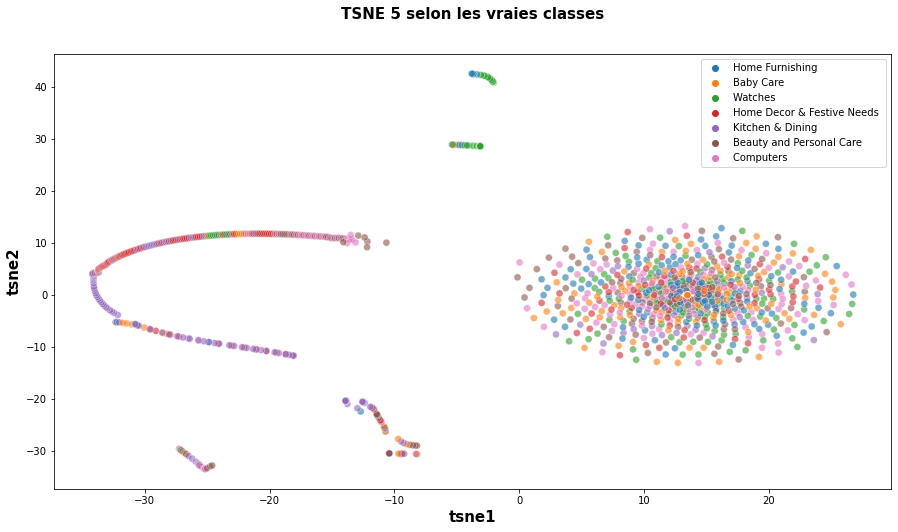

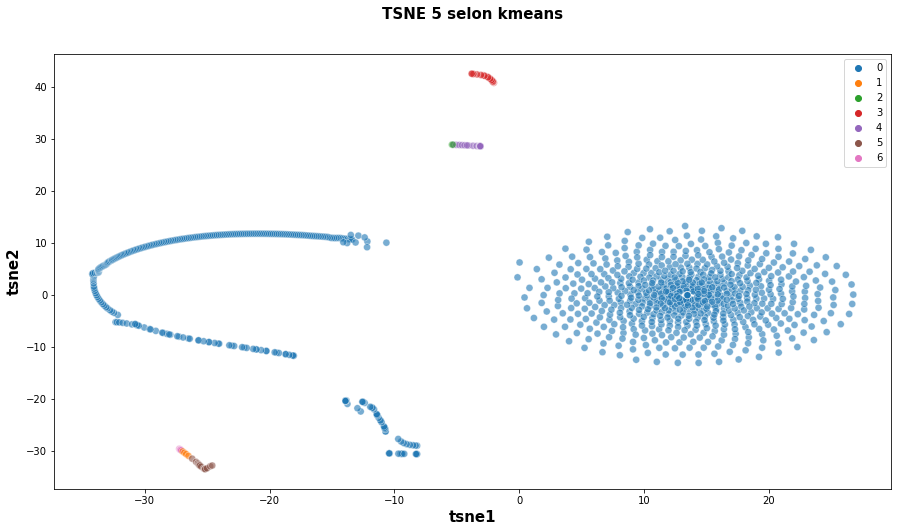

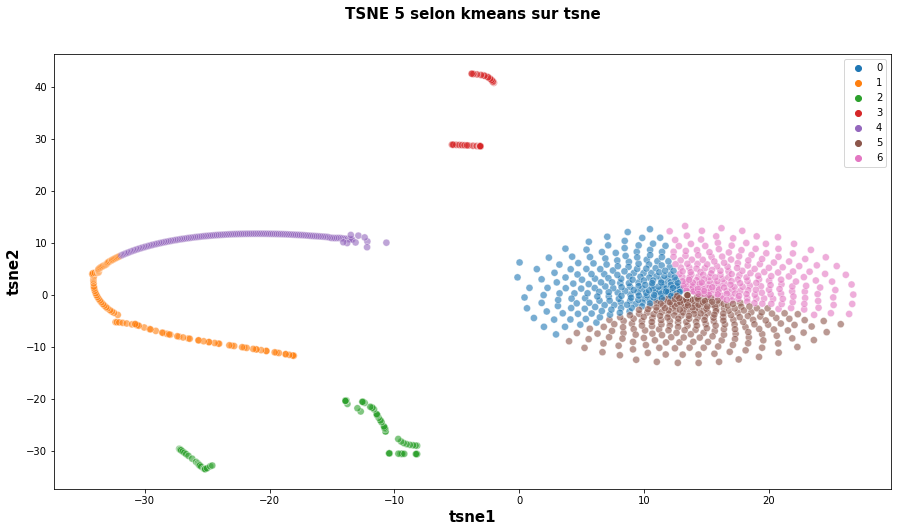

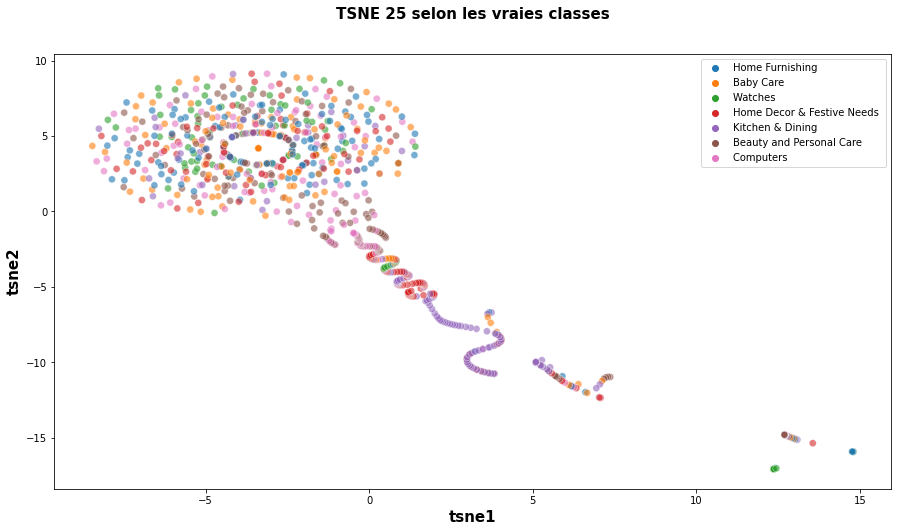

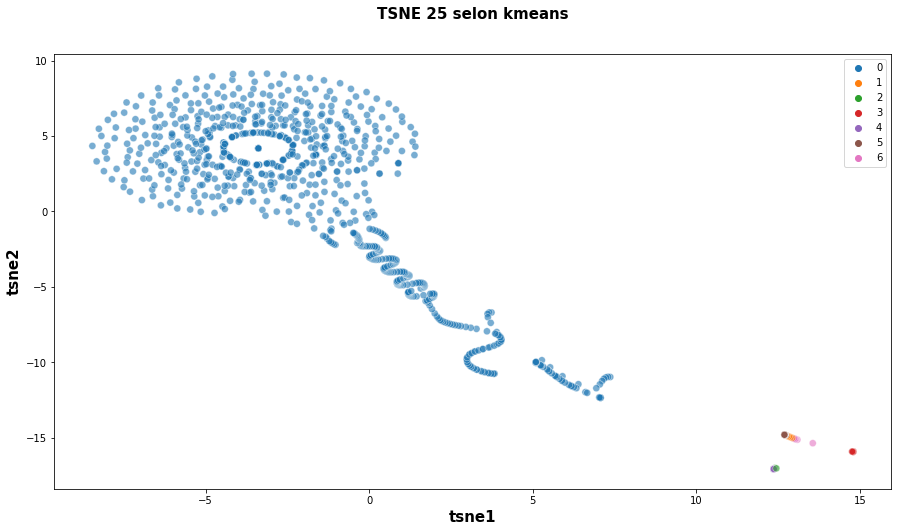

...

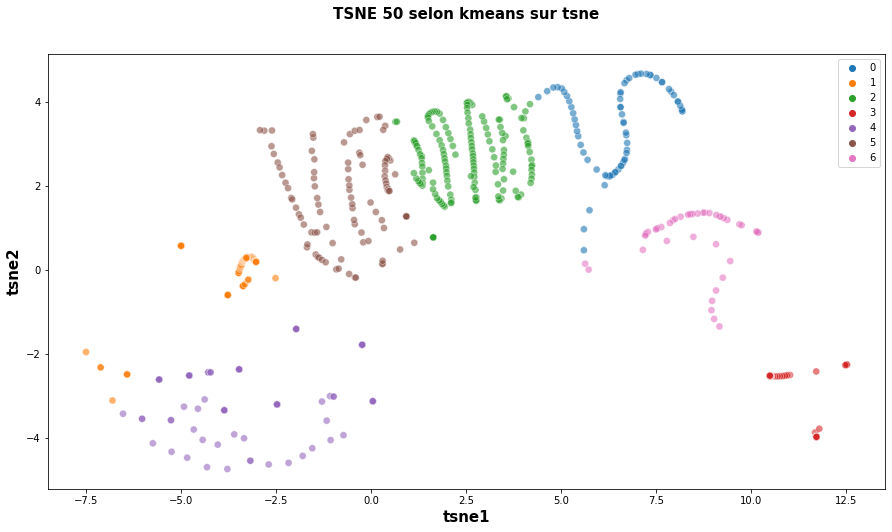

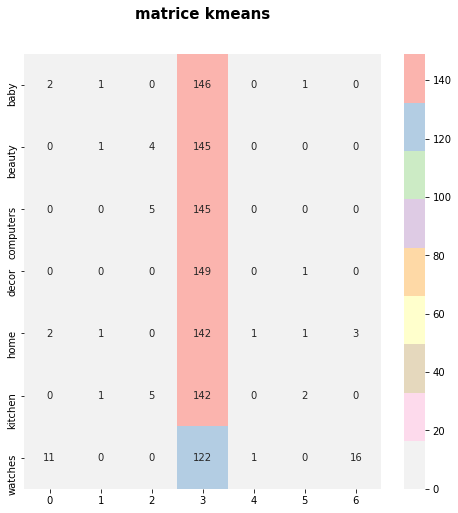

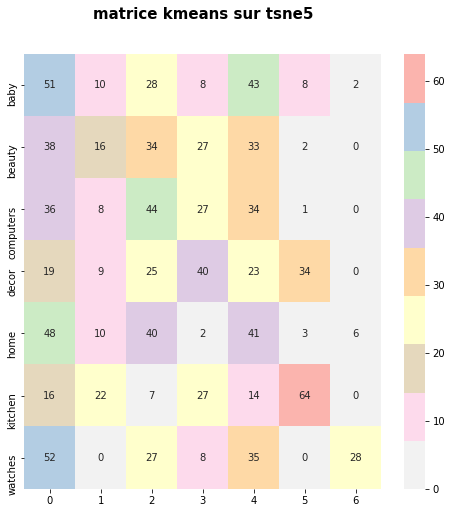

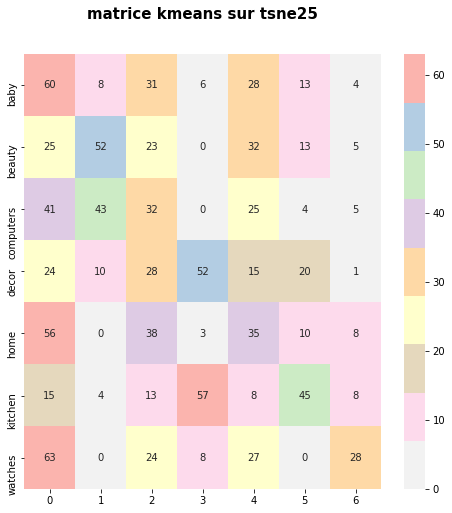

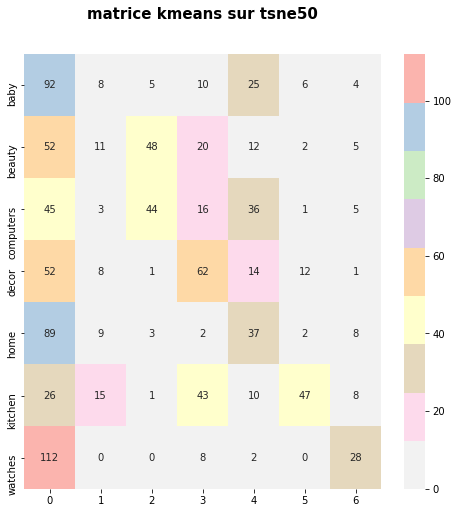

silhouette score :  -0.09199981
ARi score :  0.0017194972533781563
ARi score tsne5 :  0.051643837336827925
ARi score tsne25 :  0.07438222128936671
ARi score tsne50 :  0.07838858520519806


In [480]:
result = (analyse(X_df,"VGG16_brut"))
df_result_tot = df_result_tot.append(result)

## Suppression de la derniere couche du model vgg16

In [481]:
from keras.applications.vgg16 import VGG16
from keras.layers import Dense
from keras import Model
from tensorflow.keras.layers import GlobalMaxPooling2D
# Charger VGG-16 pré-entraîné sur ImageNet et sans les couches fully-connected


In [482]:
vgg  = VGG16(include_top=False, weights='imagenet', input_shape=(224, 224, 3), pooling="avg")
vgg.summary()

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_15 (InputLayer)       [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

In [483]:
# identification des points clés et des descripteurs associés
import time, cv2
vgg_keypoints = []
temps1=time.time()
#sift = cv2.xfeatures2d.SIFT_create(500)

for image_num in range(len(list_photos)) :
    if image_num%100 == 0 : print(image_num)
    image = load_img(list_photos[image_num], target_size=(224, 224))  # Charger l'image
    image = img_to_array(image)  # Convertir en tableau numpy
    image = preprocess_input(np.expand_dims(image.copy(), axis=0))
    image = preprocess_input(image)

    des = vgg.predict(image).reshape(-1)
    vgg_keypoints.append(des)

img_feat = pd.Series(vgg_keypoints)

duration1=time.time()-temps1
print("temps de traitement vgg descriptor : ", "%15.2f" % duration1, "secondes")

0
100
200
300
400
500
600
700
800
900
1000
temps de traitement vgg descriptor :           578.89 secondes


In [484]:
X_df = pd.DataFrame.from_dict(dict(zip(img_feat.index, img_feat.values))).T
X_df.shape

(1050, 512)

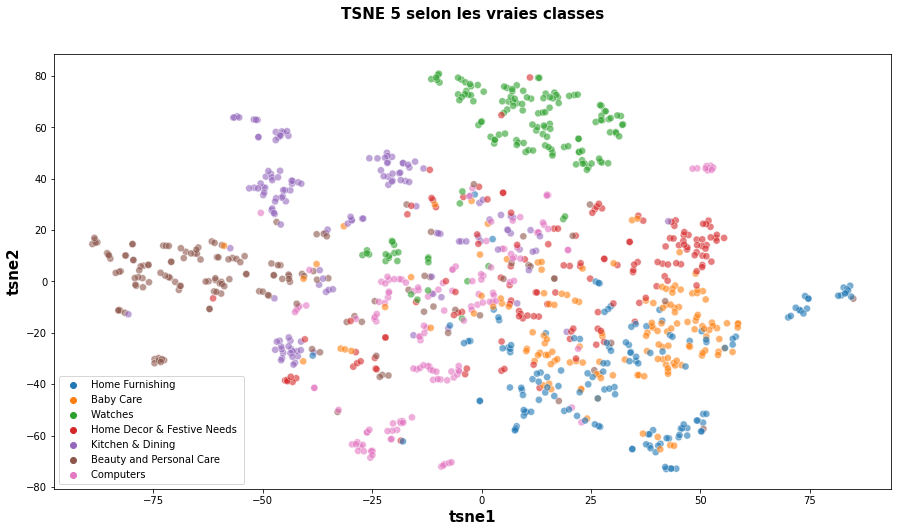

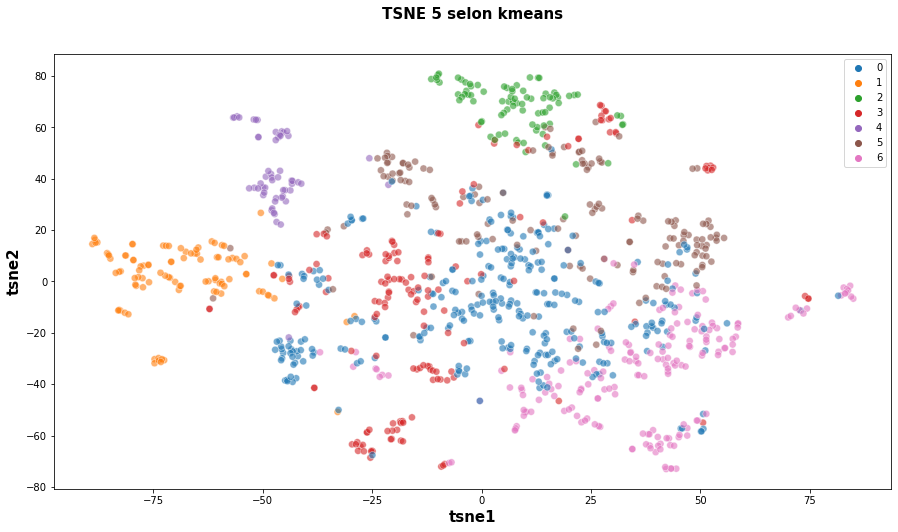

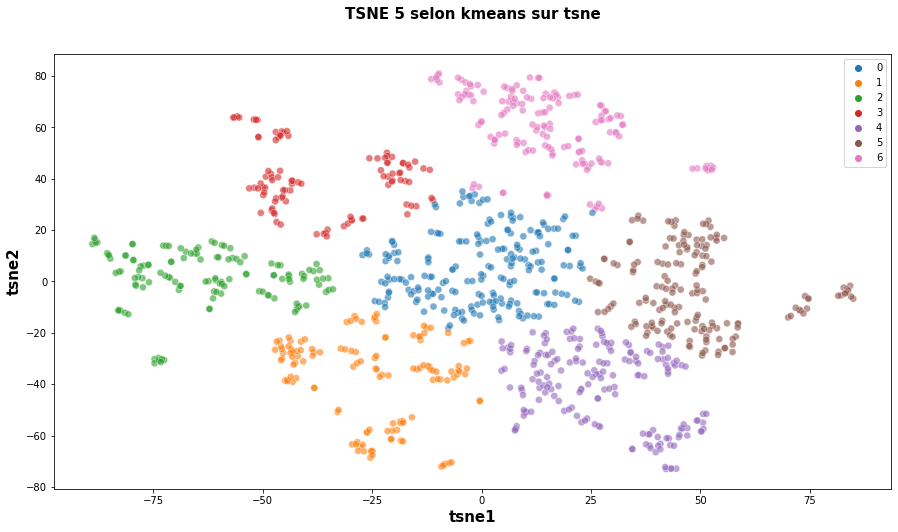

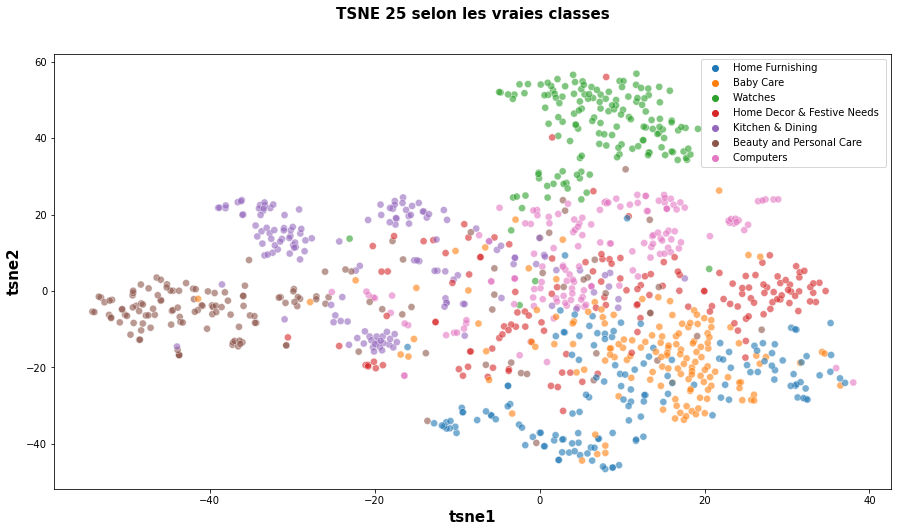

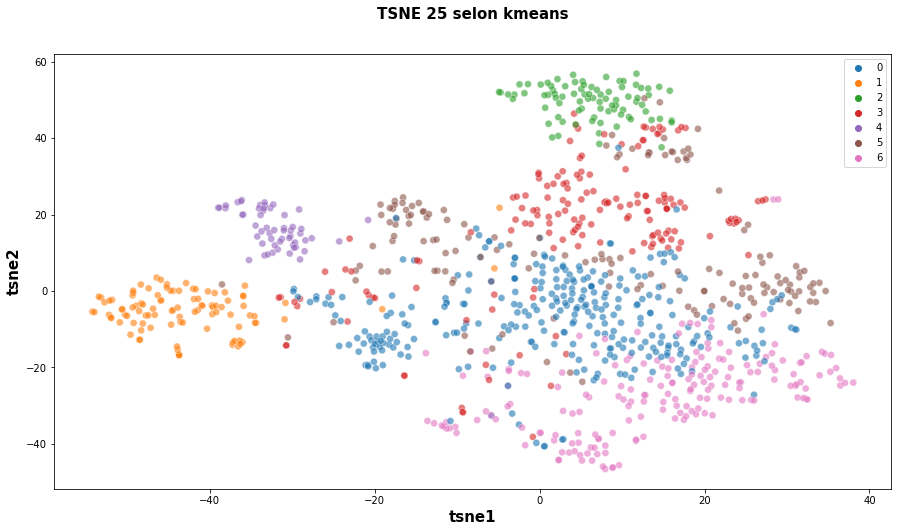

...

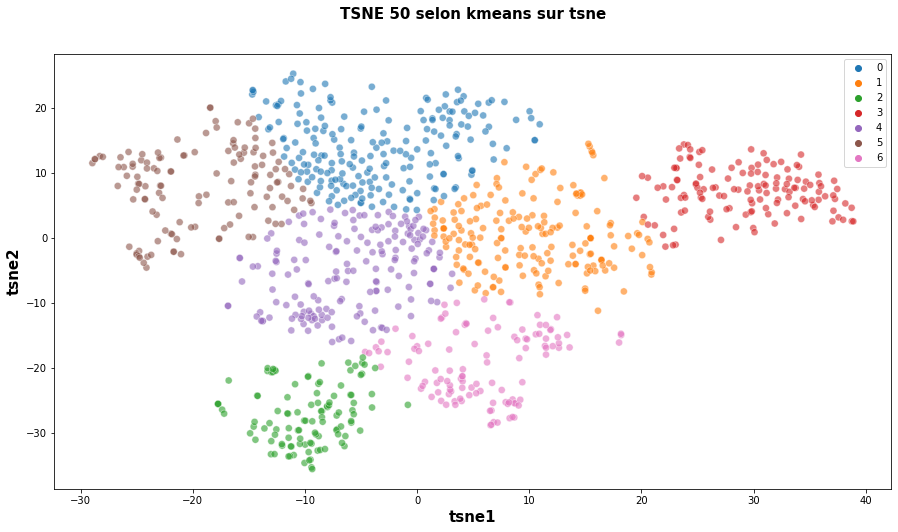

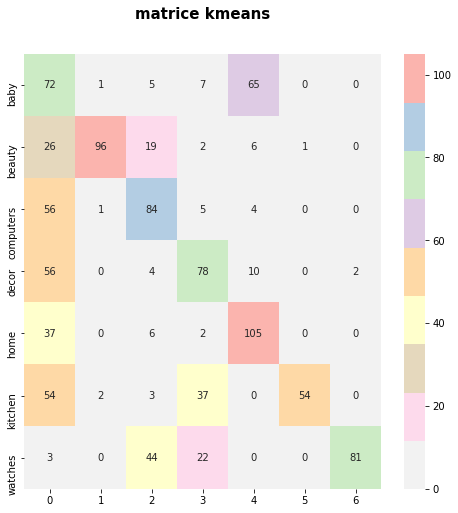

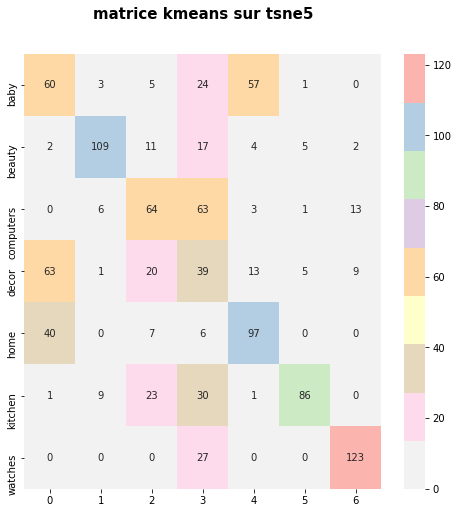

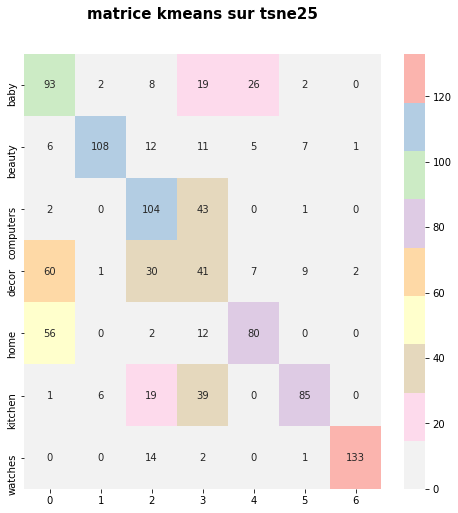

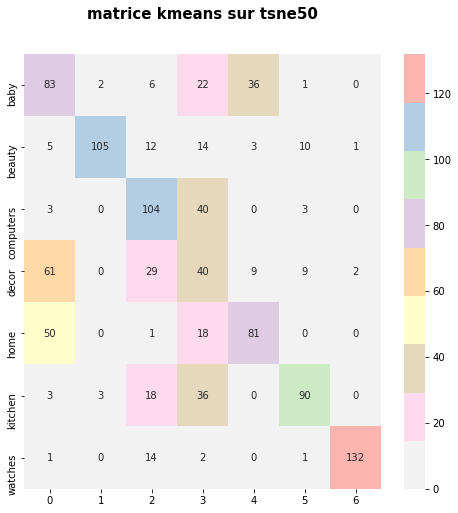

silhouette score :  0.021058846
ARi score :  0.26031187243978704
ARi score tsne5 :  0.33407248133052514
ARi score tsne25 :  0.38165883852732524
ARi score tsne50 :  0.3736212362669529


In [485]:
result = (analyse(X_df,"VGG16_sans_derniere_couche"))
df_result_tot = df_result_tot.append(result)

In [486]:
X_df_pca = best_reduc_svd(X_df)

Dimensions dataset avant réduction svd :  (1050, 512)
variance après réduction svd :  0.9898355
Dimensions dataset après réduction svd :  (1050, 346)


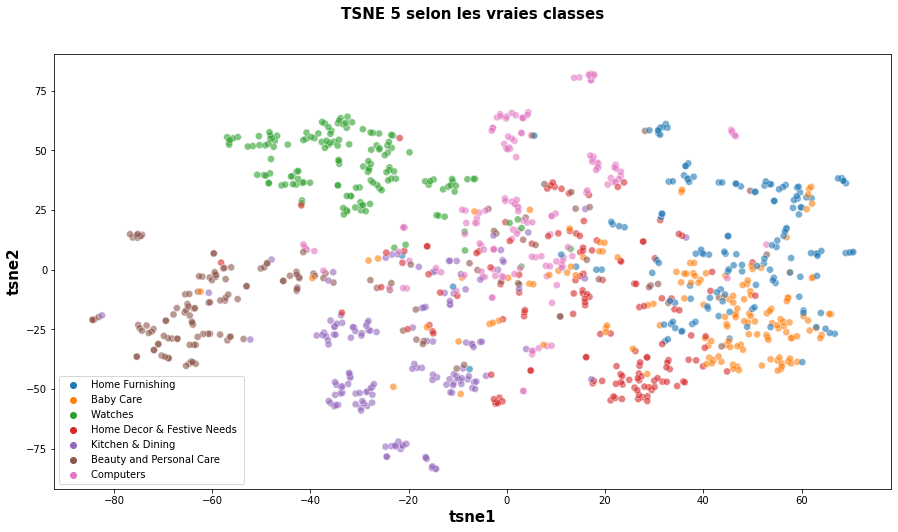

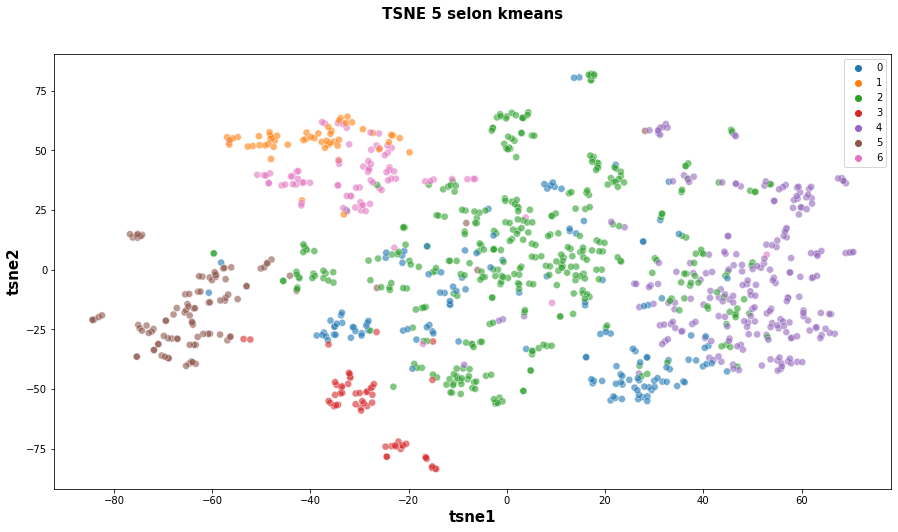

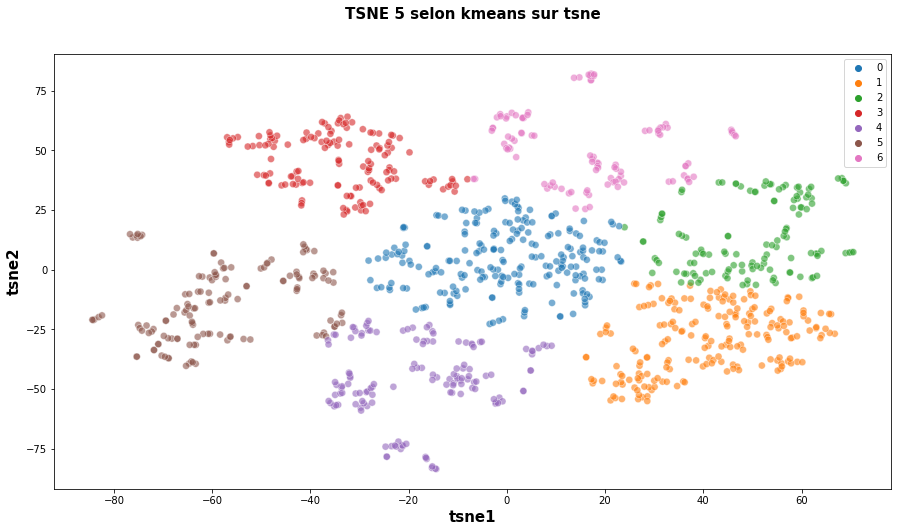

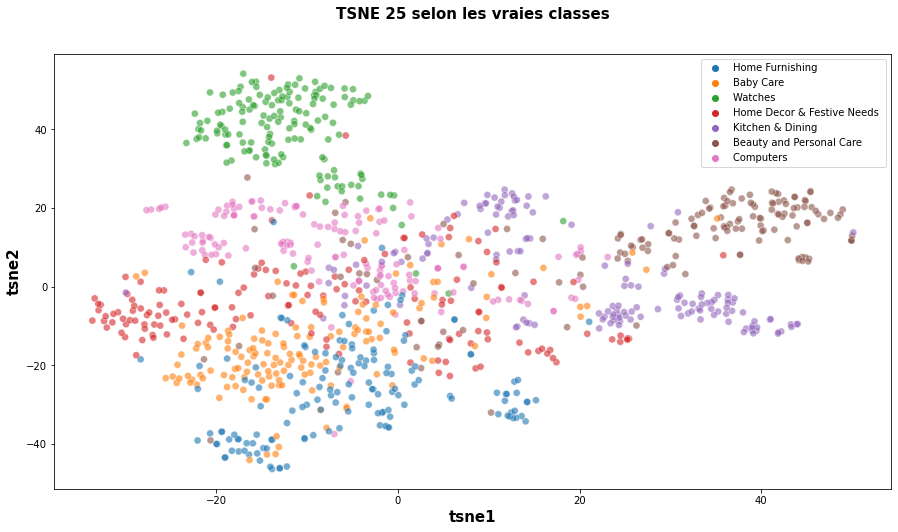

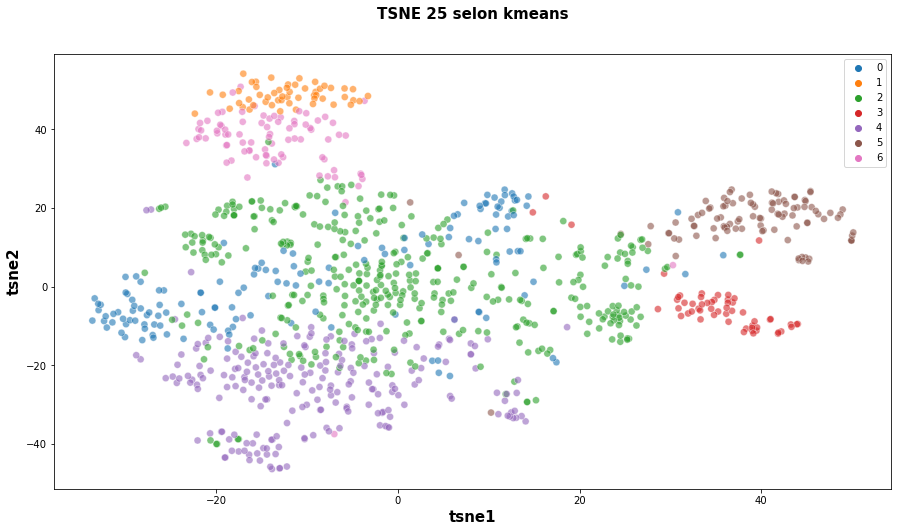

...

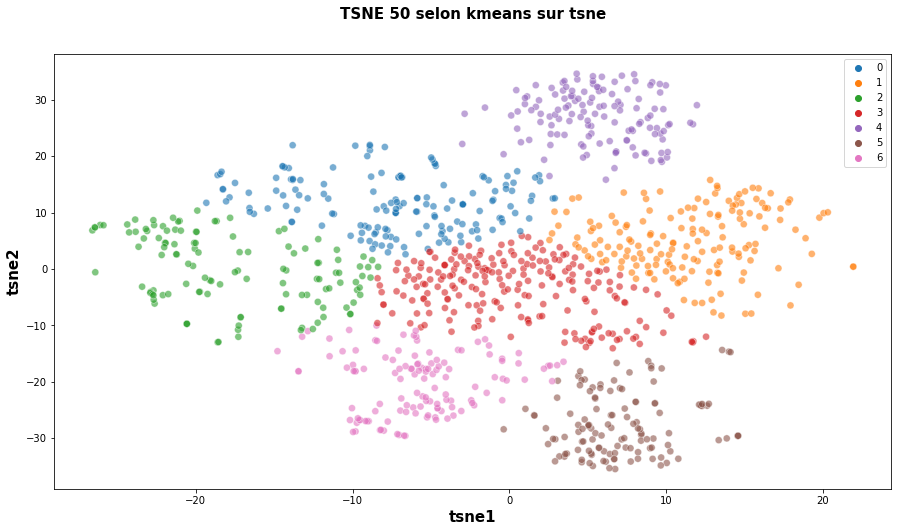

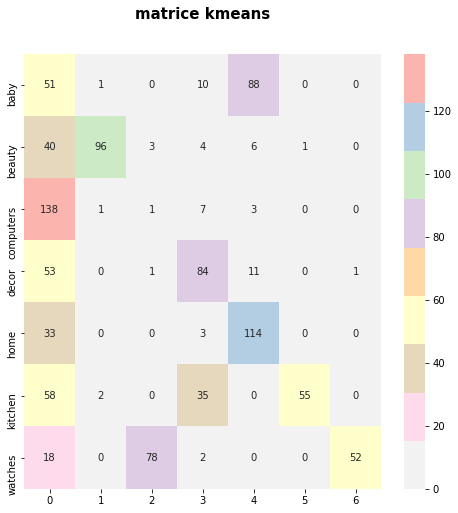

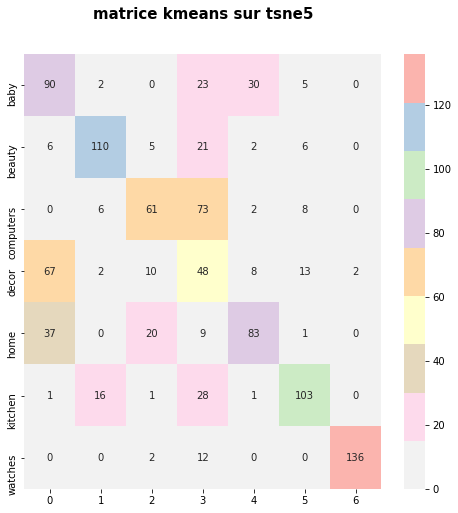

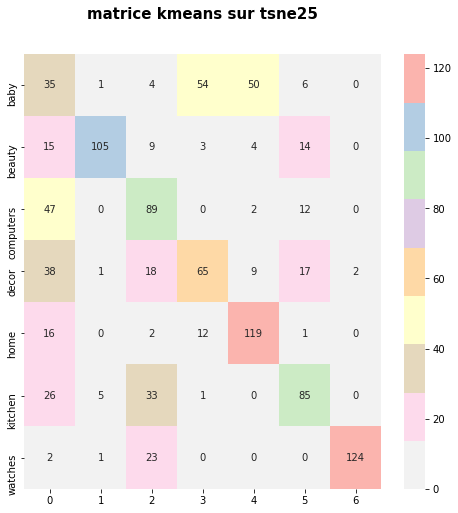

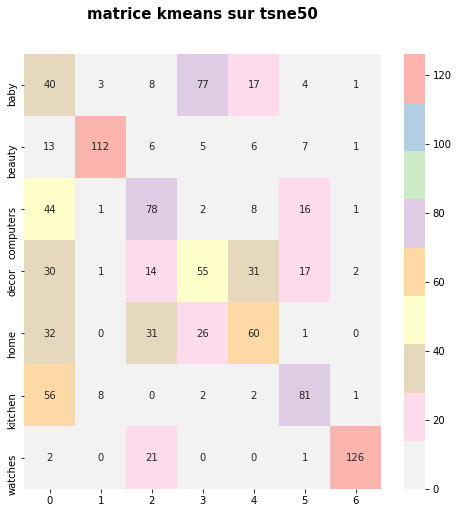

silhouette score :  0.011794582
ARi score :  0.2736198770527949
ARi score tsne5 :  0.38254144874970775
ARi score tsne25 :  0.37019695073971587
ARi score tsne50 :  0.31139810239553384


In [487]:
result = (analyse(X_df_pca,"VGG16_sans_derniere_couche"))
df_result_tot = df_result_tot.append(result)

## VGG19

In [488]:
from keras.applications.vgg19 import VGG19

model = VGG19() # Création du modèle VGG-16 implementé par Keras

In [489]:
vgg19  = VGG19(include_top=False, weights='imagenet', input_shape=(224, 224, 3), pooling="max")
vgg19.summary()

Model: "vgg19"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_17 (InputLayer)       [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

In [490]:
# identification des points clés et des descripteurs associés
import time, cv2
vgg_keypoints = []
temps1=time.time()
#sift = cv2.xfeatures2d.SIFT_create(500)

for image_num in range(len(list_photos)) :
    if image_num%100 == 0 : print(image_num)
    image = load_img(list_photos[image_num], target_size=(224, 224))  # Charger l'image
    image = img_to_array(image)  # Convertir en tableau numpy
    image = preprocess_input(np.expand_dims(image.copy(), axis=0))
    image = preprocess_input(image)

    des = vgg19.predict(image).reshape(-1)
    vgg_keypoints.append(des)

img_feat = pd.Series(vgg_keypoints)

duration1=time.time()-temps1
print("temps de traitement vgg descriptor : ", "%15.2f" % duration1, "secondes")

0
100
200
300
400
500
600
700
800
900
1000
temps de traitement vgg descriptor :           701.17 secondes


In [491]:
X_df = pd.DataFrame.from_dict(dict(zip(img_feat.index, img_feat.values))).T
X_df.shape

(1050, 512)

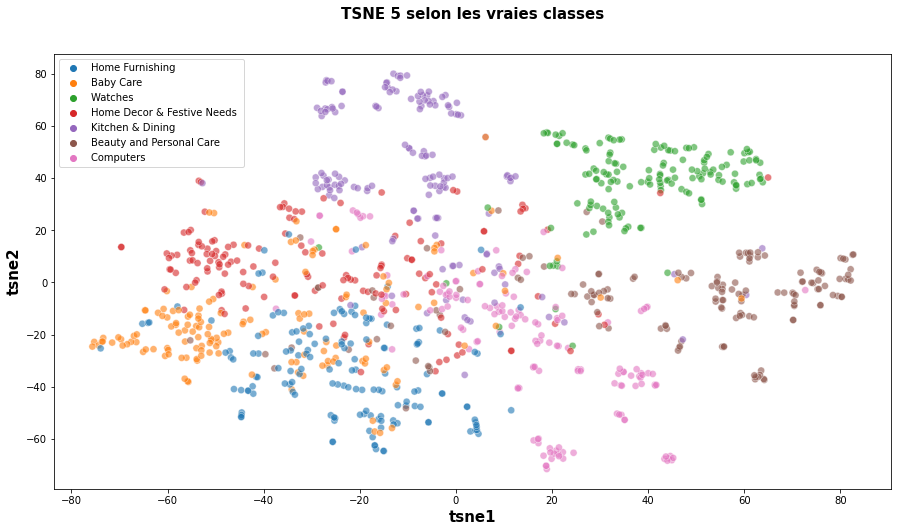

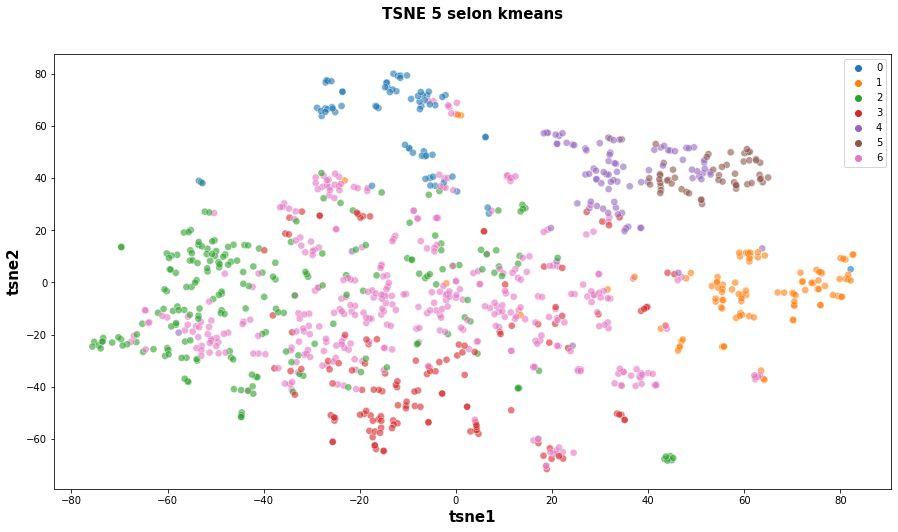

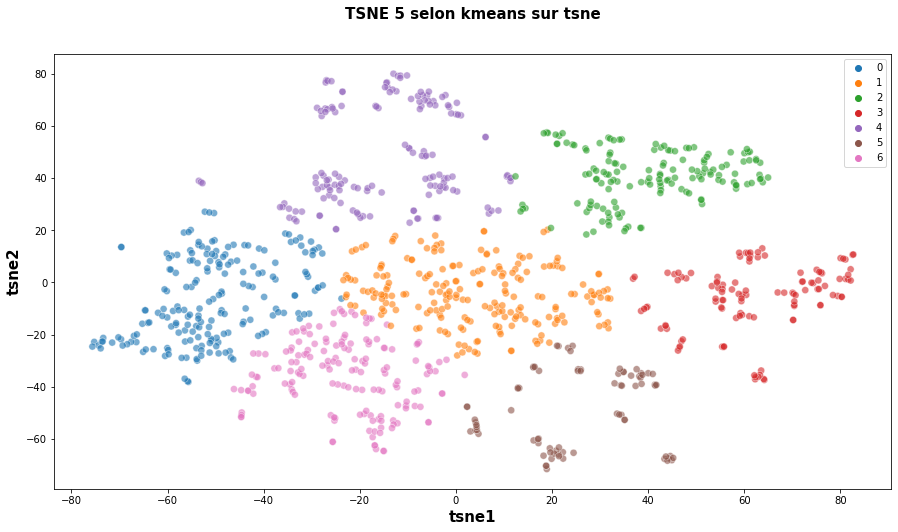

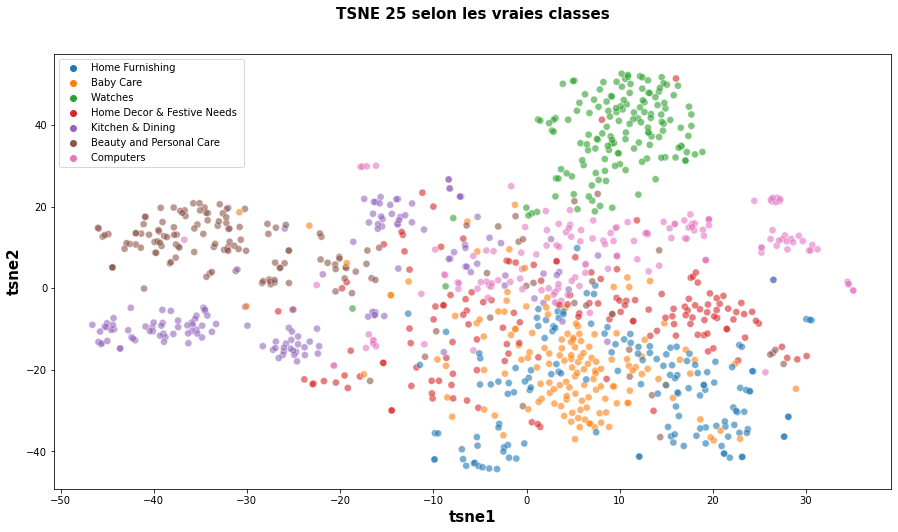

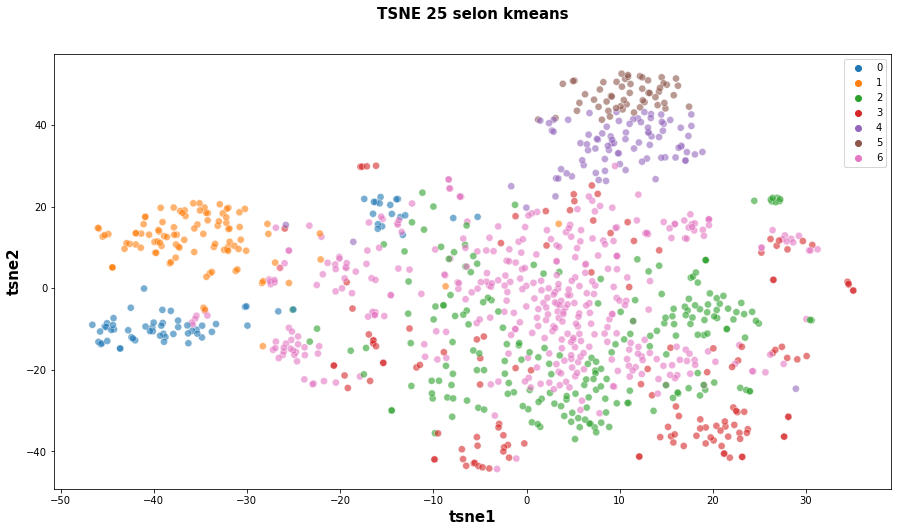

...

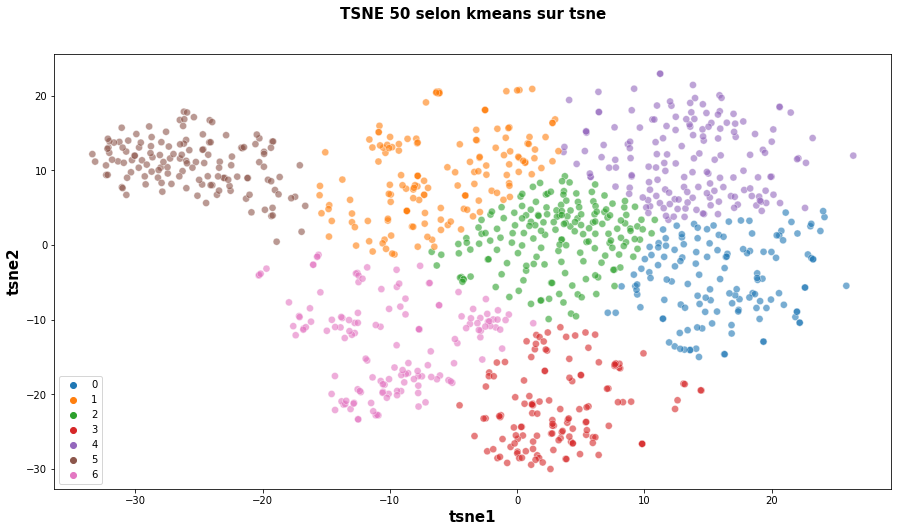

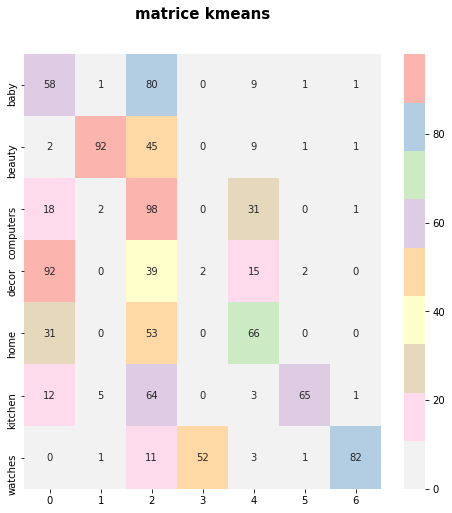

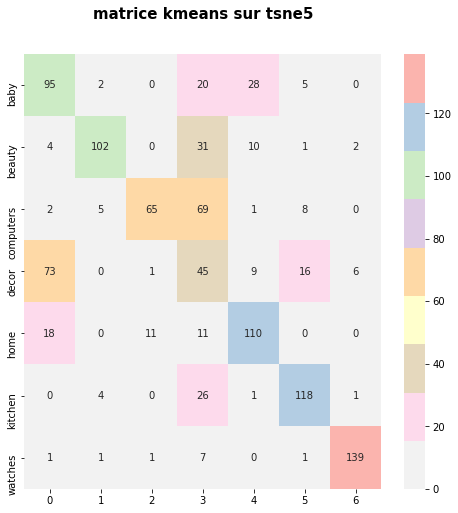

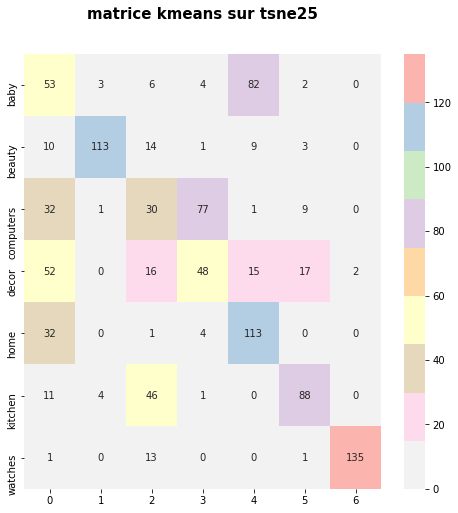

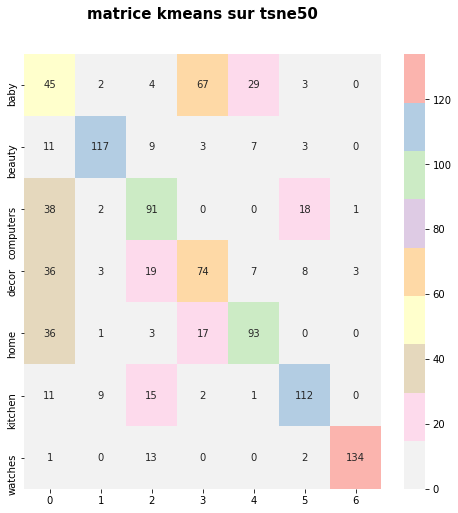

silhouette score :  0.0158063
ARi score :  0.1980836940132781
ARi score tsne5 :  0.43490368835695653
ARi score tsne25 :  0.39318376782936154
ARi score tsne50 :  0.41931580488139614


In [492]:
result = (analyse(X_df,"VGG19_sans_derniere_couche"))
df_result_tot = df_result_tot.append(result)

In [493]:
X_df_pca = best_reduc_svd(X_df)

Dimensions dataset avant réduction svd :  (1050, 512)
variance après réduction svd :  0.9898975
Dimensions dataset après réduction svd :  (1050, 396)


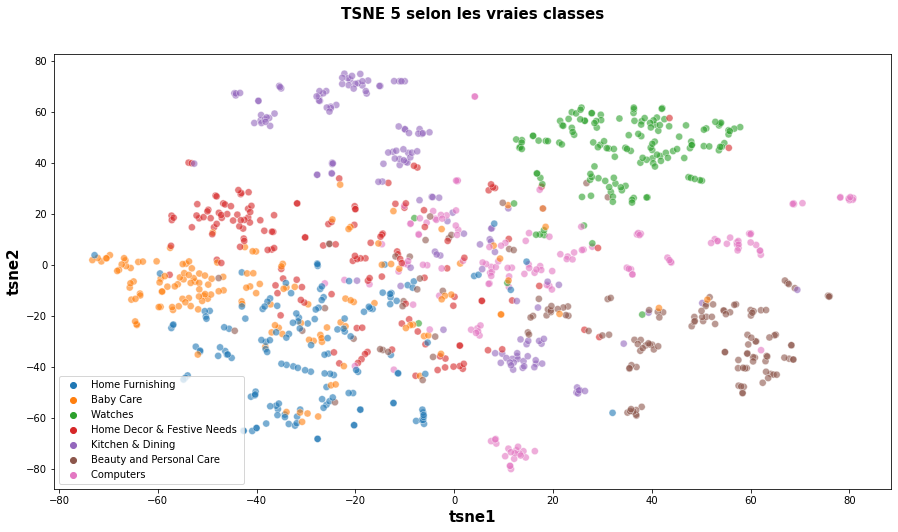

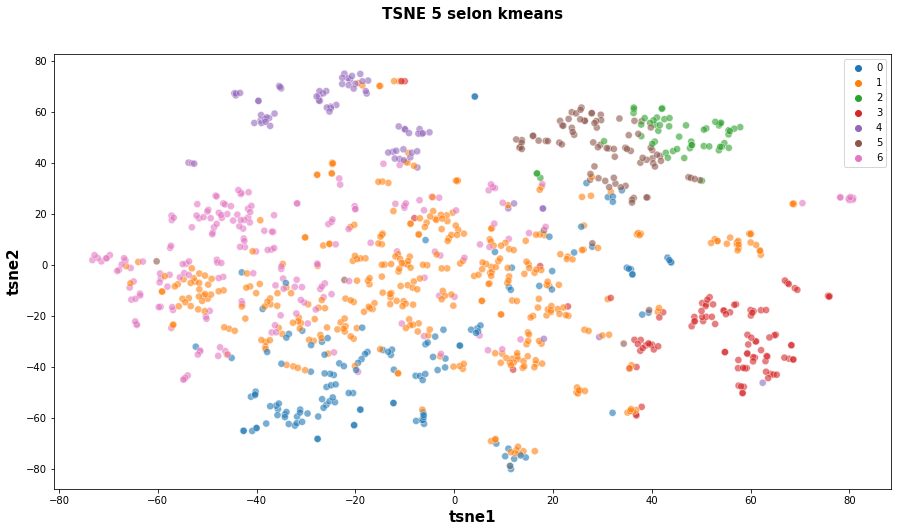

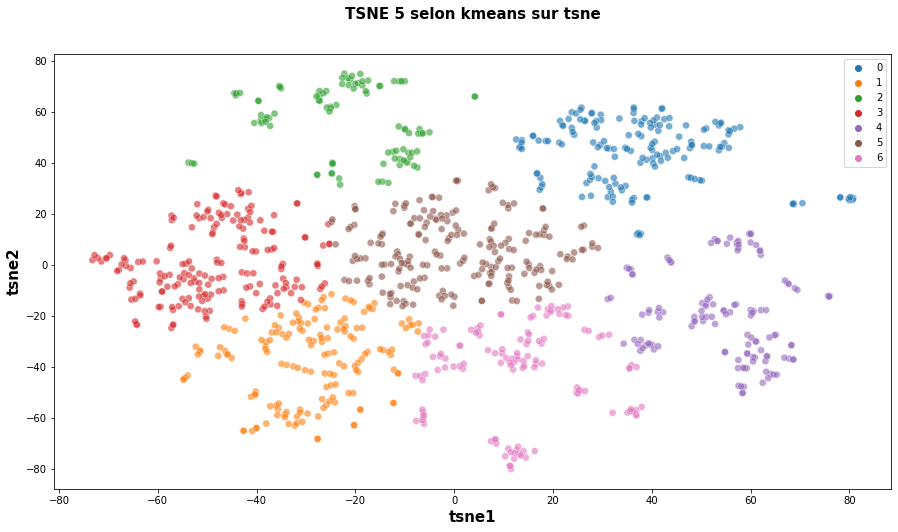

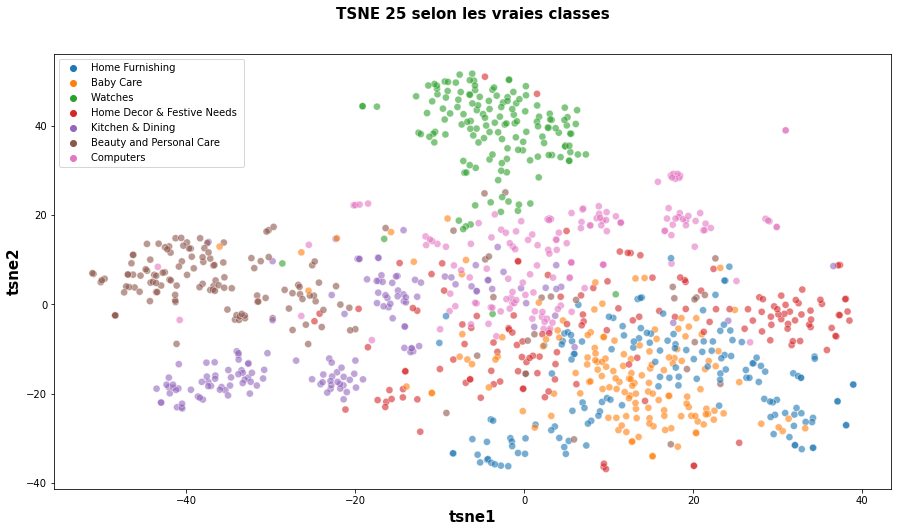

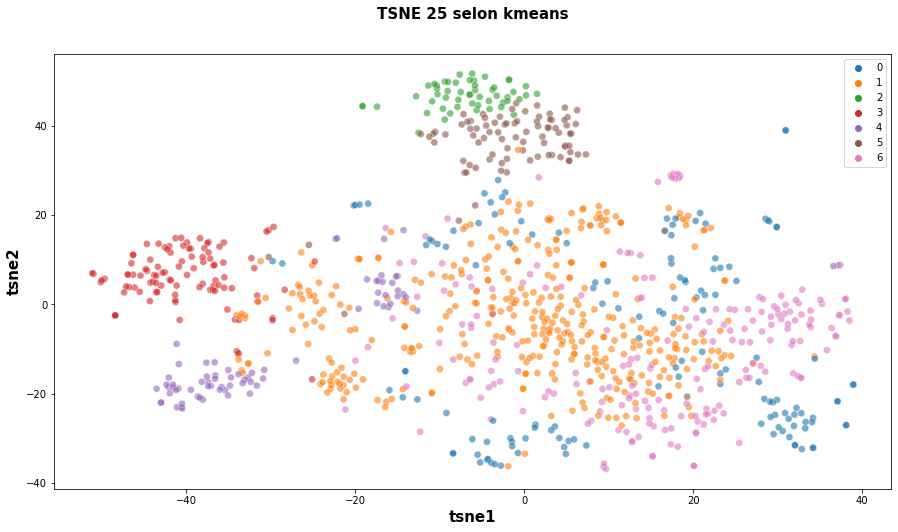

...

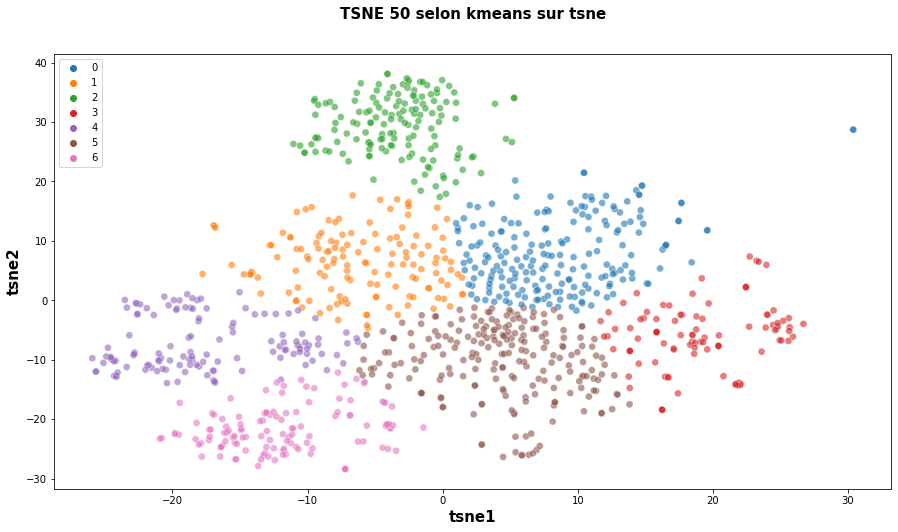

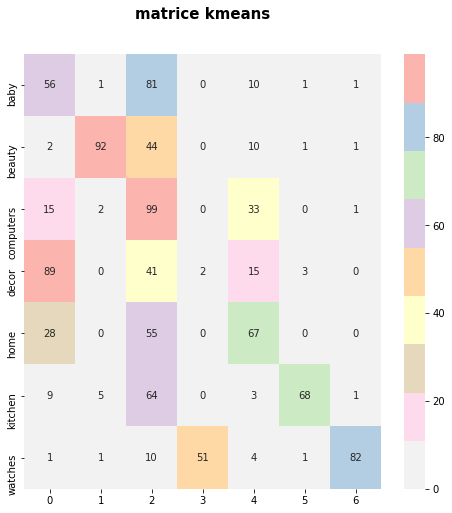

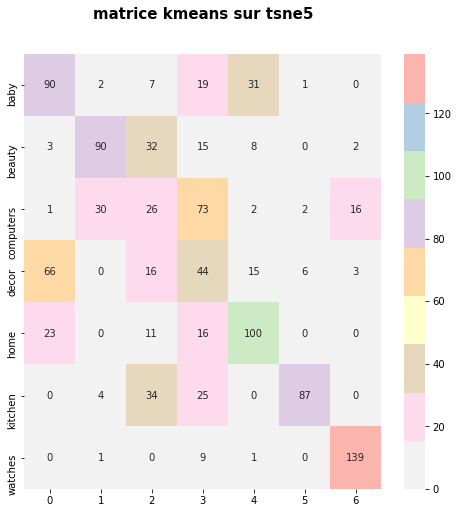

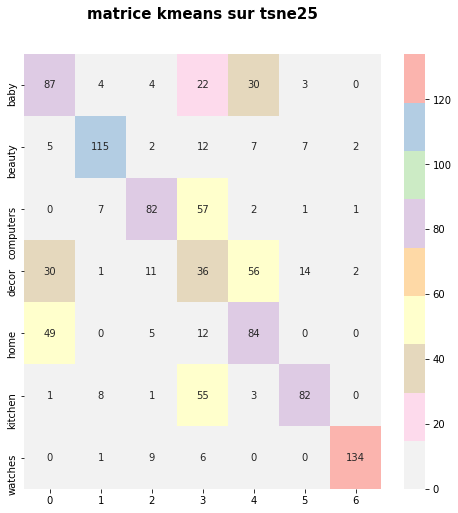

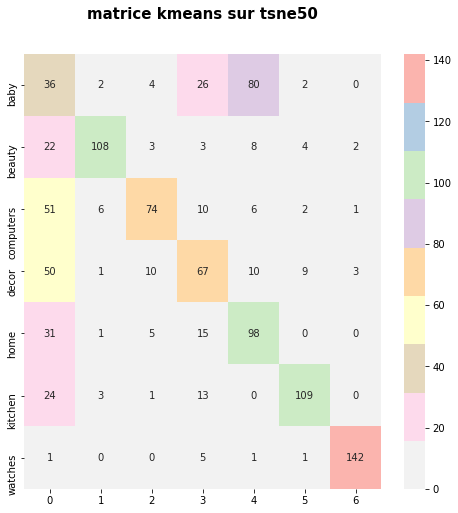

silhouette score :  0.036589496
ARi score :  0.198951092490616
ARi score tsne5 :  0.3515536244187477
ARi score tsne25 :  0.37520907755822136
ARi score tsne50 :  0.3973014816470143


In [494]:
result = (analyse(X_df_pca,"VGG19_sans_derniere_couche_pca"))
df_result_tot = df_result_tot.append(result)

## ResNet50

In [495]:
from keras.preprocessing import image

In [496]:
from tensorflow.keras.applications import ResNet50

In [497]:
resnet = ResNet50(weights='imagenet',include_top=False, input_shape= (224,224,3) , pooling="max")

In [498]:
resnet.summary()

Model: "resnet50"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_18 (InputLayer)          [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 230, 230, 3)  0           ['input_18[0][0]']               
                                                                                                  
 conv1_conv (Conv2D)            (None, 112, 112, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                                                                                           

In [499]:
# identification des points clés et des descripteurs associés
import time, cv2
vgg_keypoints = []
temps1=time.time()
#sift = cv2.xfeatures2d.SIFT_create(500)

for image_num in range(len(list_photos)) :
    if image_num%100 == 0 : print(image_num)
    image = load_img(list_photos[image_num], target_size=(224, 224))  # Charger l'image
    image = img_to_array(image)  # Convertir en tableau numpy
    image = preprocess_input(np.expand_dims(image.copy(), axis=0))
    image = preprocess_input(image)

    des = resnet.predict(image).reshape(-1)
    vgg_keypoints.append(des)

img_feat = pd.Series(vgg_keypoints)

duration1=time.time()-temps1
print("temps de traitement vgg descriptor : ", "%15.2f" % duration1, "secondes")

0
100
200
300
400
500
600
700
800
900
1000
temps de traitement vgg descriptor :           291.52 secondes


In [500]:
X_df = pd.DataFrame.from_dict(dict(zip(img_feat.index, img_feat.values))).T
X_df.shape

(1050, 2048)

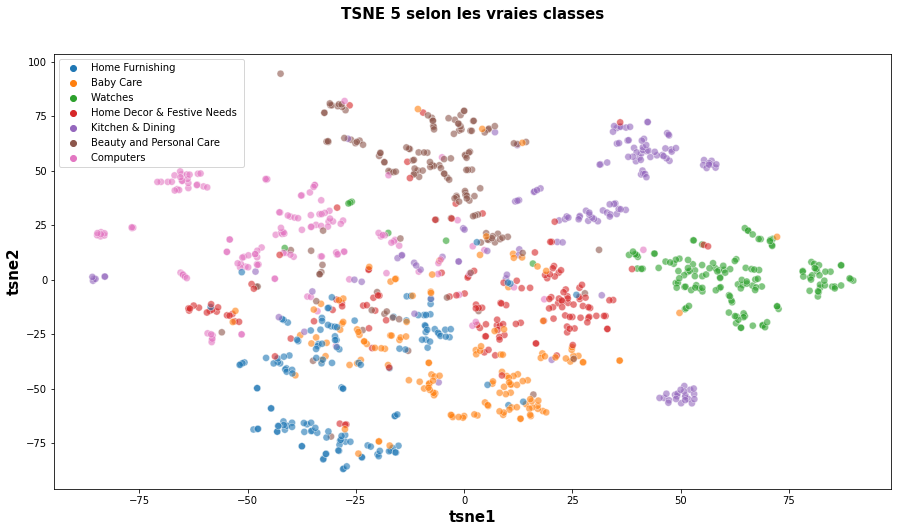

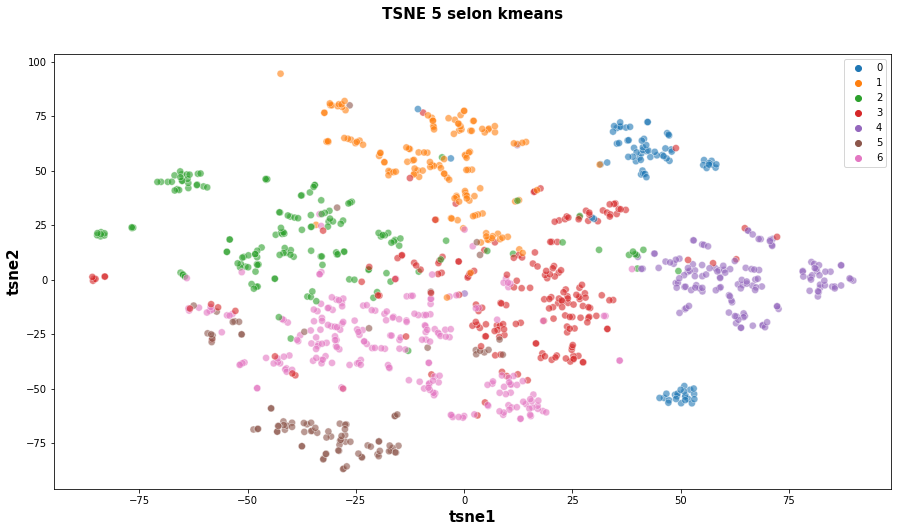

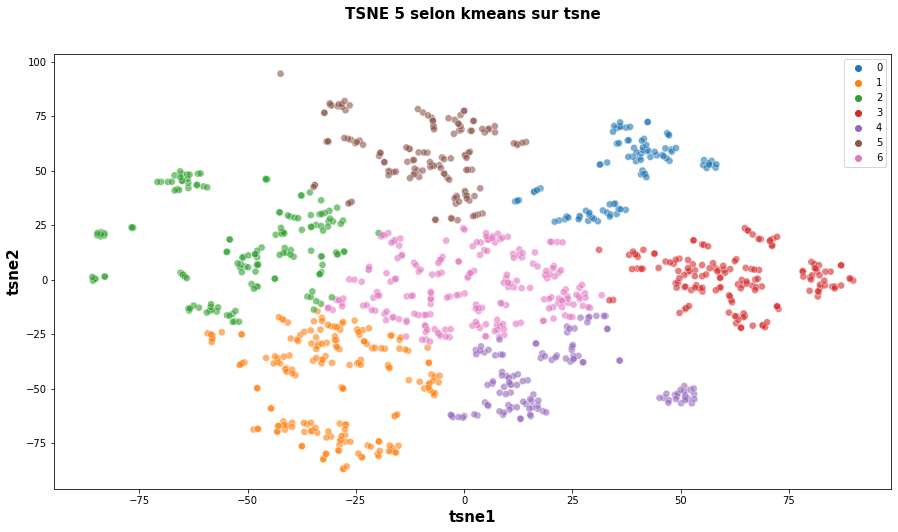

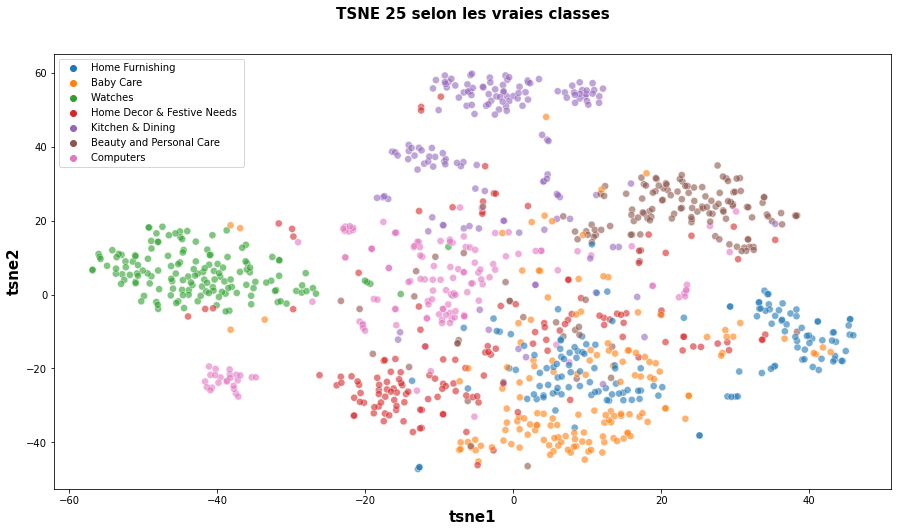

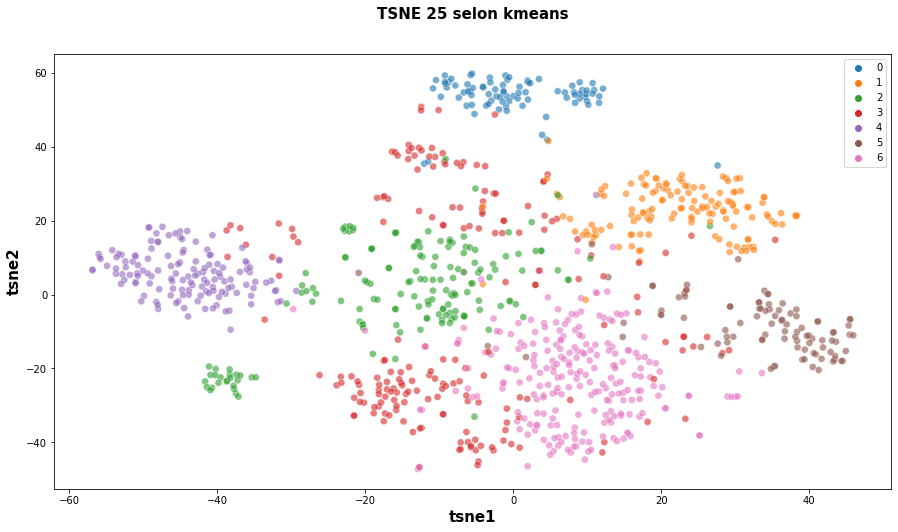

...

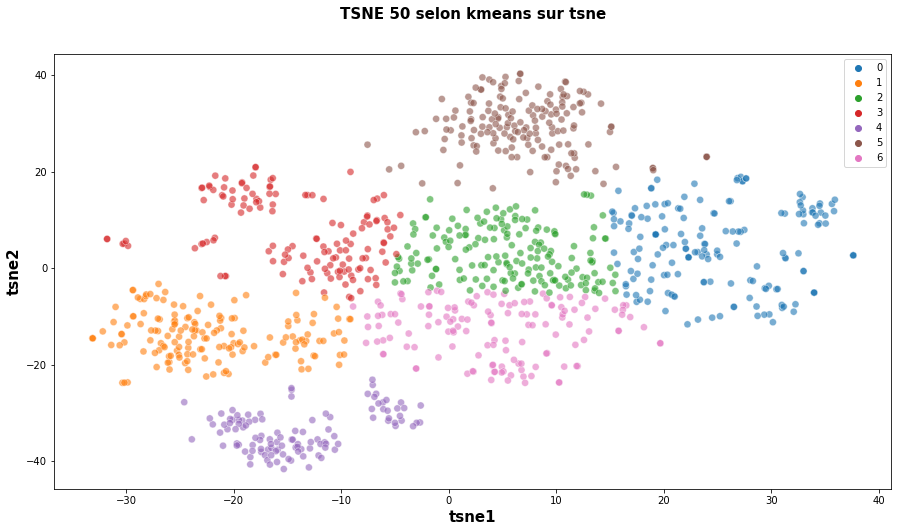

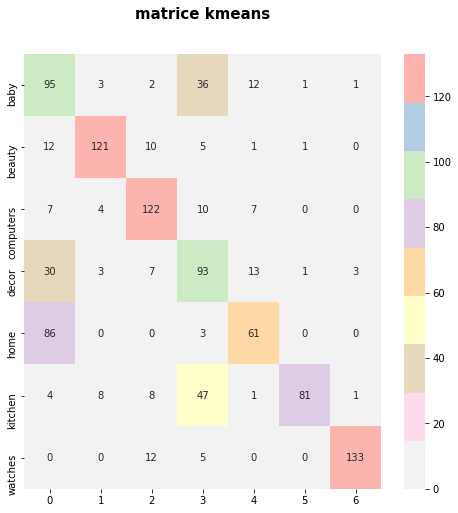

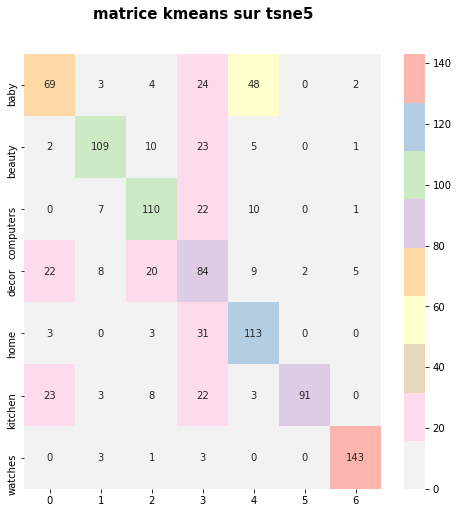

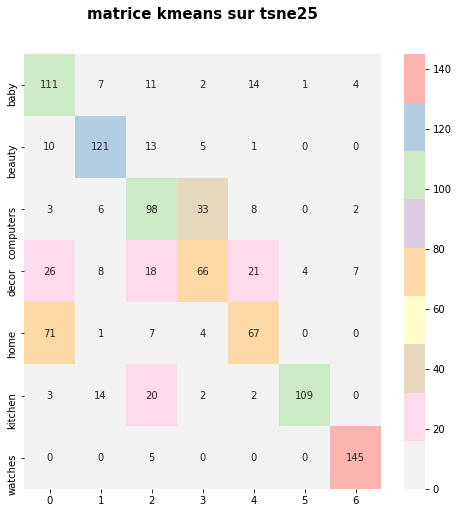

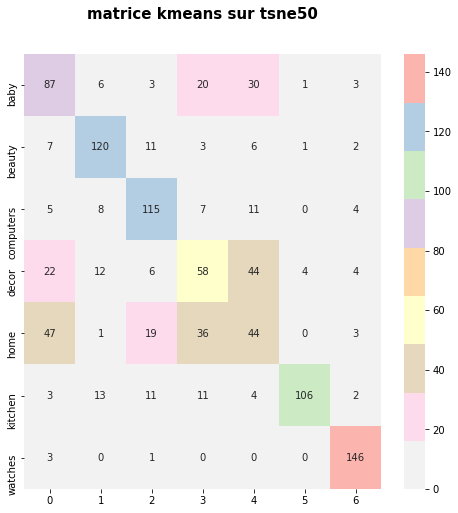

silhouette score :  0.042659104
ARi score :  0.4448739457408415
ARi score tsne5 :  0.43624111356145745
ARi score tsne25 :  0.4554755004760789
ARi score tsne50 :  0.4300018261360485


In [501]:
result = (analyse(X_df,"resnet_sans_derniere_couche"))
df_result_tot = df_result_tot.append(result)

In [502]:
X_df_pca = best_reduc_svd(X_df)

Dimensions dataset avant réduction svd :  (1050, 2048)
variance après réduction svd :  0.9898319
Dimensions dataset après réduction svd :  (1050, 810)


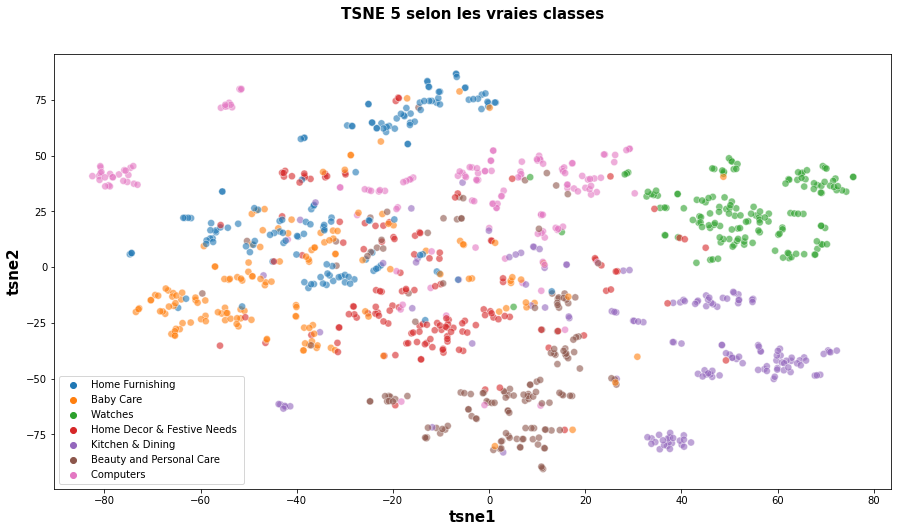

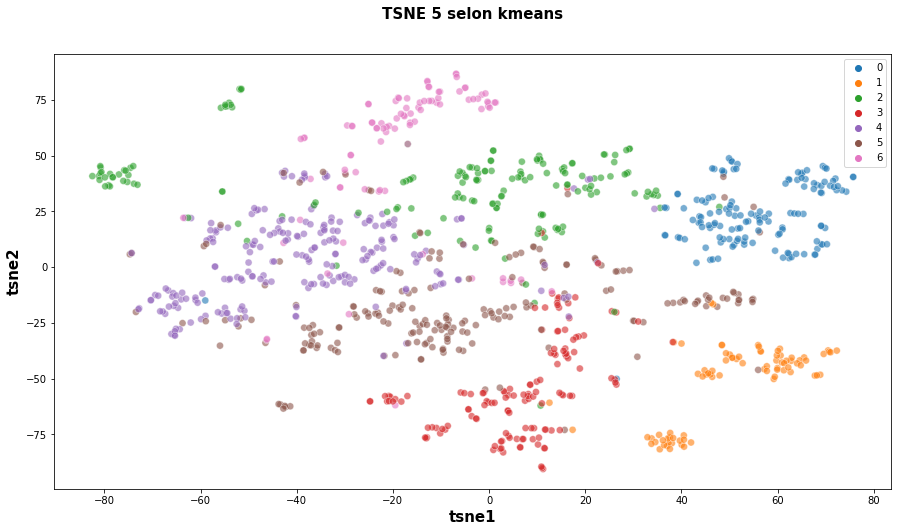

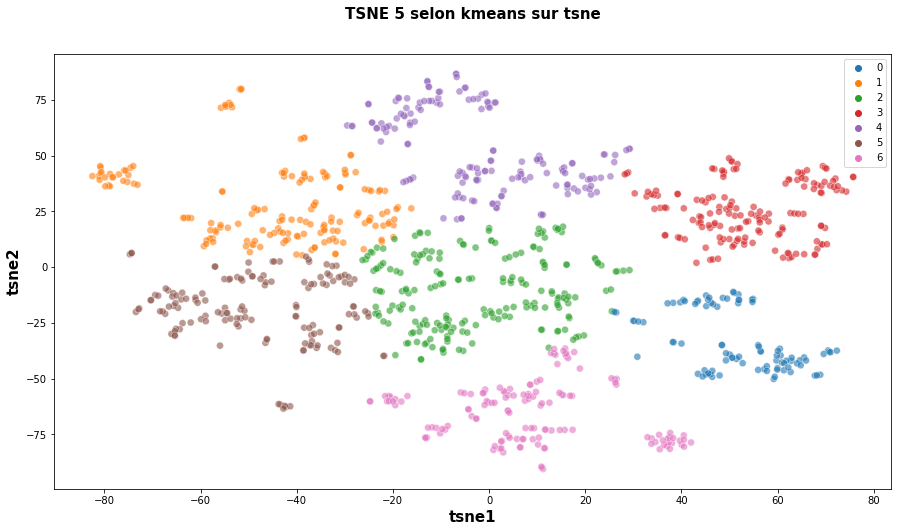

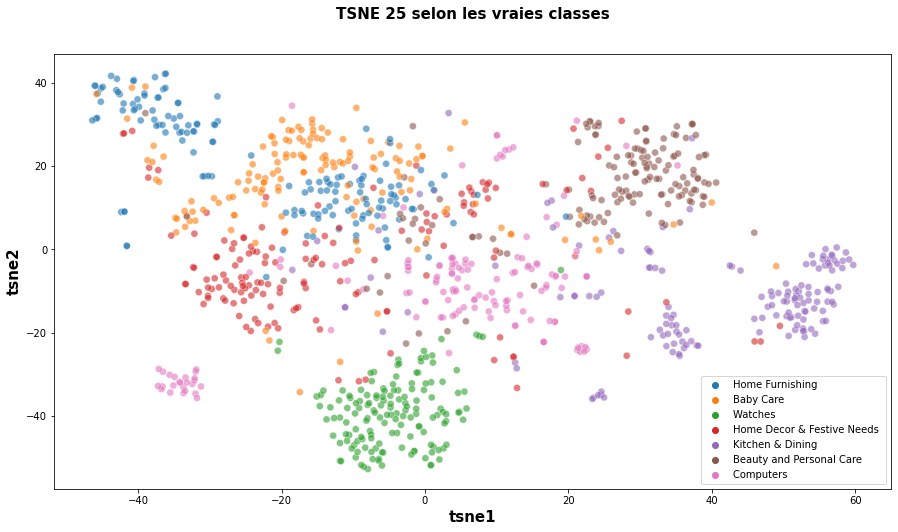

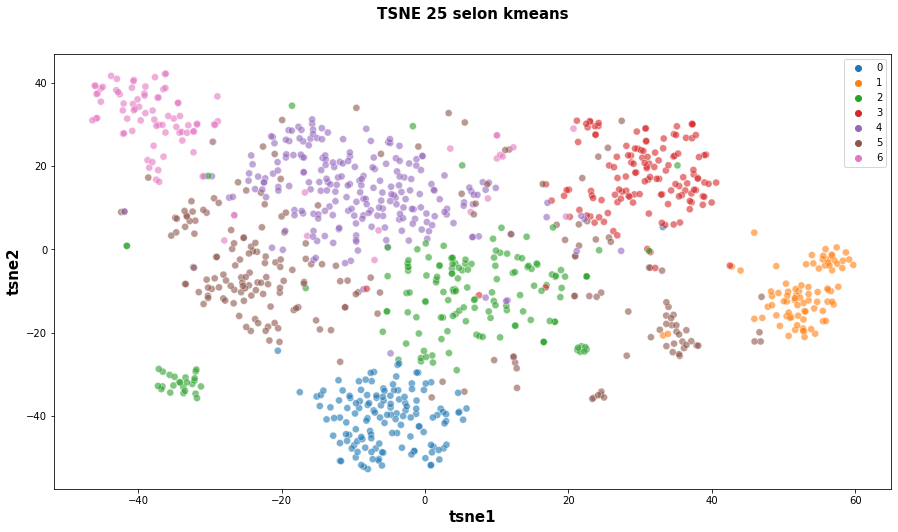

...

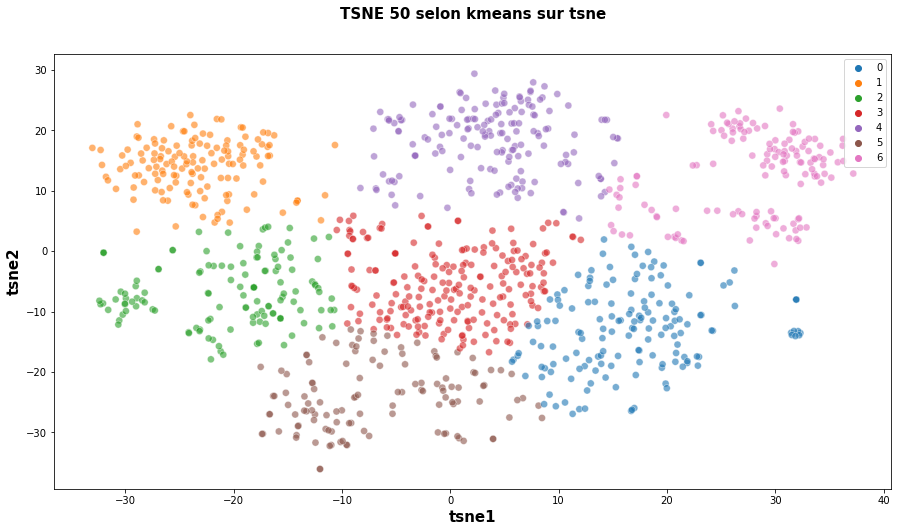

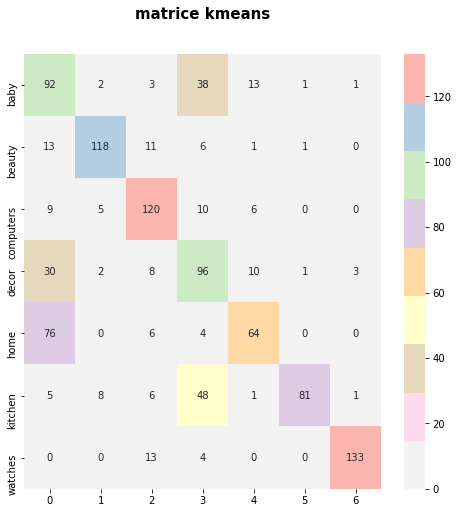

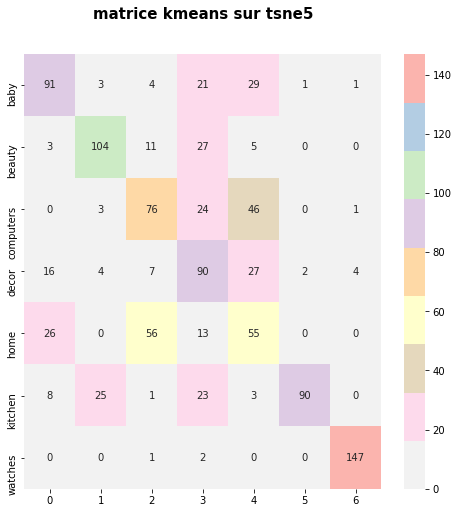

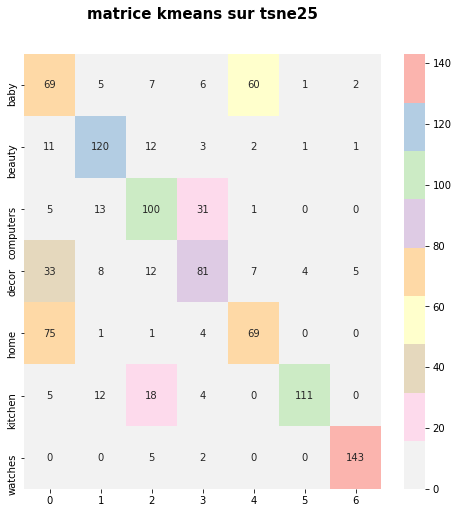

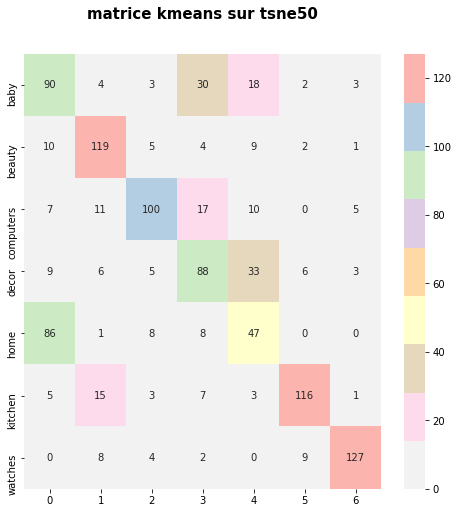

silhouette score :  0.0474473
ARi score :  0.4307678974179103
ARi score tsne5 :  0.38652256774554955
ARi score tsne25 :  0.45803724253706635
ARi score tsne50 :  0.43462811106769134


In [503]:
result = (analyse(X_df_pca,"resnet_sans_derniere_couche_pca"))
df_result_tot = df_result_tot.append(result)

In [504]:
df_result_tot

,Model,ARI,kmeans silouette score,ARI_tsne5,ARI_tsne25,ARI_tsne50
0,sift,0.027601,-0.059153,0.043494,0.042533,0.052479
0,orb,0.046254,-0.012143,0.037890,0.056713,0.044286
0,VGG16_brut,0.001719,-0.092000,0.051644,0.074382,0.078389
0,VGG16_sans_derniere_couche,0.260312,0.021059,0.334072,0.381659,0.373621
0,VGG16_sans_derniere_couche,0.273620,0.011795,0.382541,0.370197,0.311398
0,VGG19_sans_derniere_couche,0.198084,0.015806,0.434904,0.393184,0.419316
0,VGG19_sans_derniere_couche_pca,0.198951,0.036589,0.351554,0.375209,0.397301
0,resnet_sans_derniere_couche,0.444874,0.042659,0.436241,0.455476,0.430002
0,resnet_sans_derniere_couche_pca,0.430768,0.047447,0.386523,0.458037,0.434628


### Analyse d'erreures

In [521]:
kmeans = KMeans(n_clusters=7, random_state=6, init='k-means++', n_init=10, max_iter=1000)
tsne50 = manifold.TSNE(perplexity=50 , n_iter=1000, init='random', random_state=0)
X_tsne50 = tsne50.fit_transform(X_df_pca)
X_kmean_tsne50 = kmeans.fit_transform(X_tsne50)
y_pred_tsne50 = pd.Series(kmeans.labels_)
df_tsne50 = pd.DataFrame(X_tsne50[:,0:2], columns=['tsne1', 'tsne2'])
df_tsne50["class"] = data["cat_1"]
df_tsne50["image_chemin"] = data["image_chemin"]
df_tsne50["kmeans_tsne50"] = y_pred_tsne50

In [522]:
df_tsne50[df_tsne50["class"] == 'Baby Care '].kmeans_tsne50.value_counts()

3    75
1    49
5    13
2     9
0     3
4     1
Name: kmeans_tsne50, dtype: int64

In [523]:
err = df_tsne50[(df_tsne50["class"] == 'Baby Care ') & (df_tsne50["kmeans_tsne50"] == 4)].index

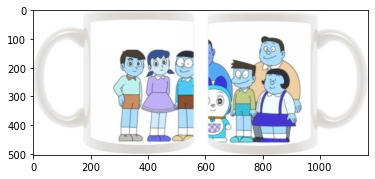

Baby Care 


In [524]:
for i in err:
  img = cv2.imread(df_tsne50.iloc[i]['image_chemin'])
  plt.imshow(img)
  plt.show()
  print(df_tsne50.iloc[i]['class'])

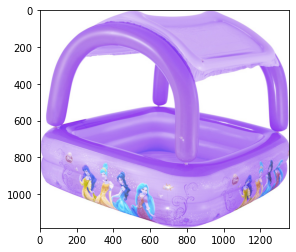

Baby Care 


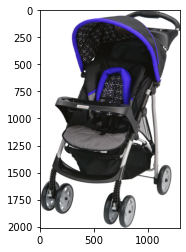

Baby Care 


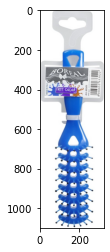

Baby Care 


In [525]:
err = df_tsne50[(df_tsne50["class"] == 'Baby Care ') & (df_tsne50["kmeans_tsne50"] == 0)].index
for i in err:
  img = cv2.imread(df_tsne50.iloc[i]['image_chemin'])
  plt.imshow(img)
  plt.show()
  print(df_tsne50.iloc[i]['class'])

In [526]:
df_tsne50[df_tsne50["class"] == 'Home Furnishing '].kmeans_tsne50.value_counts()

3    75
1    42
5    31
2     2
Name: kmeans_tsne50, dtype: int64

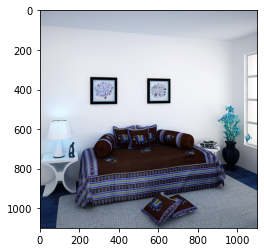

Home Furnishing 


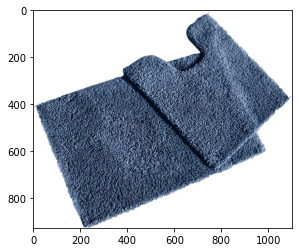

Home Furnishing 


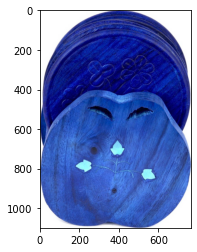

Home Furnishing 


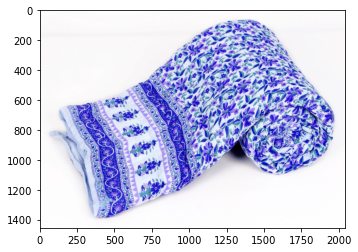

Home Furnishing 


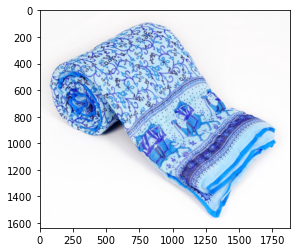

Home Furnishing 


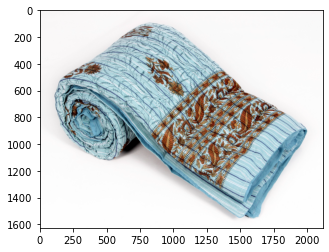

Home Furnishing 


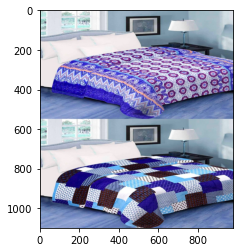

Home Furnishing 


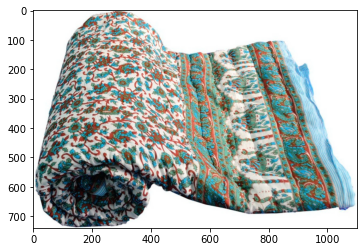

Home Furnishing 


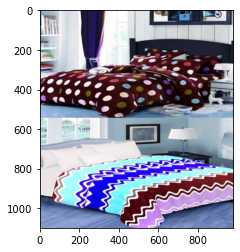

Home Furnishing 


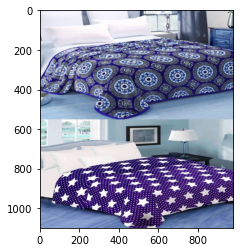

Home Furnishing 


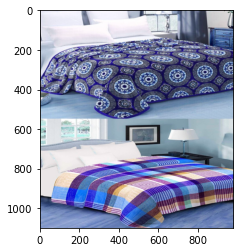

Home Furnishing 


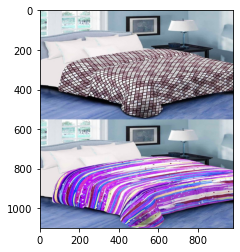

Home Furnishing 


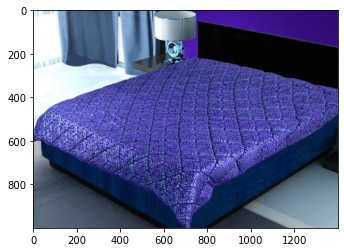

Home Furnishing 


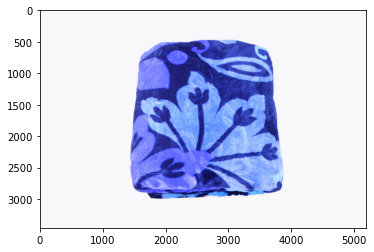

Home Furnishing 


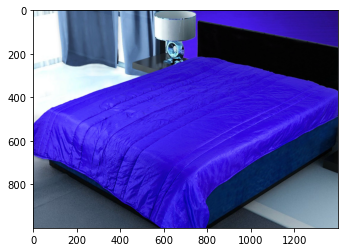

Home Furnishing 


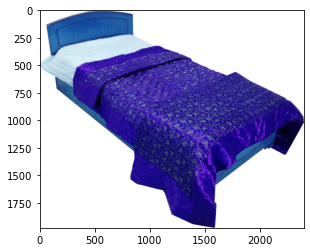

Home Furnishing 


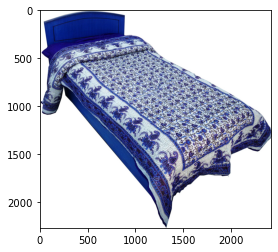

Home Furnishing 


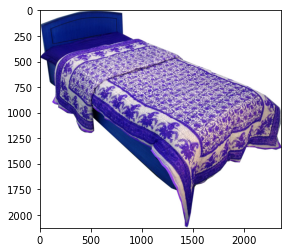

Home Furnishing 


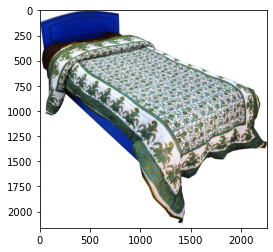

Home Furnishing 


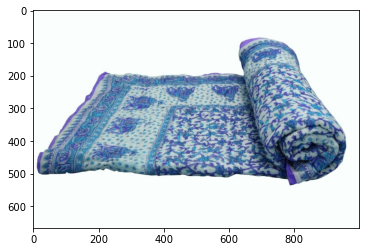

Home Furnishing 


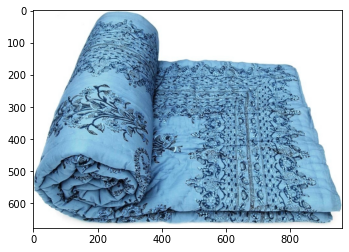

Home Furnishing 


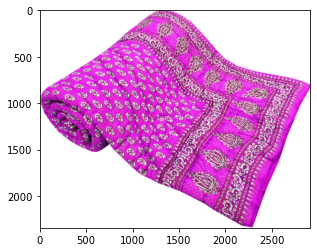

Home Furnishing 


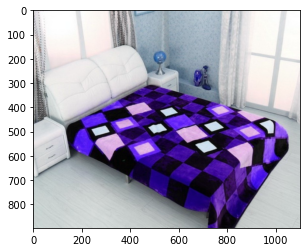

Home Furnishing 


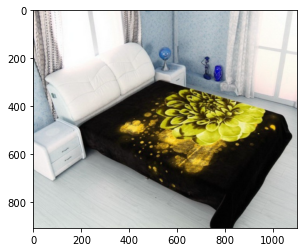

Home Furnishing 


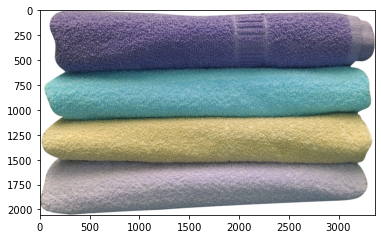

Home Furnishing 


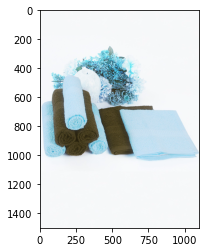

Home Furnishing 


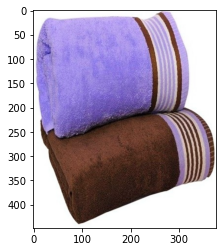

Home Furnishing 


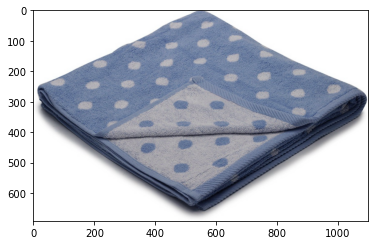

Home Furnishing 


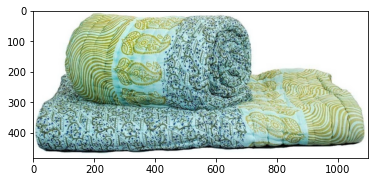

Home Furnishing 


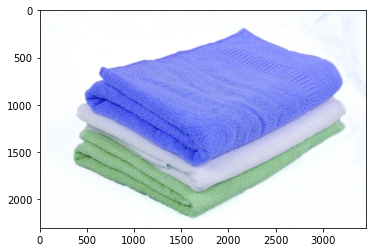

Home Furnishing 


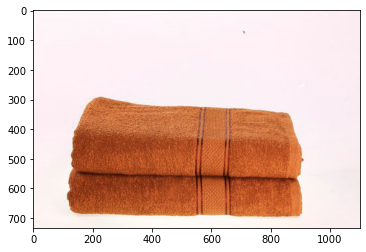

Home Furnishing 


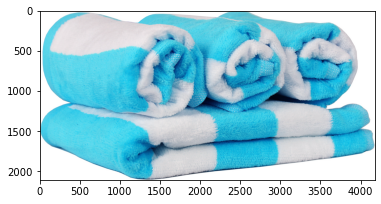

Home Furnishing 


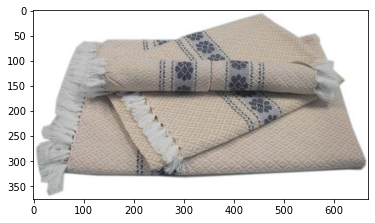

Home Furnishing 


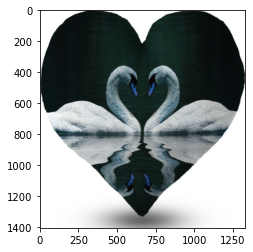

Home Furnishing 


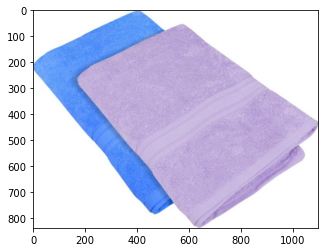

Home Furnishing 


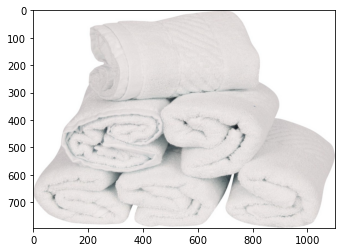

Home Furnishing 


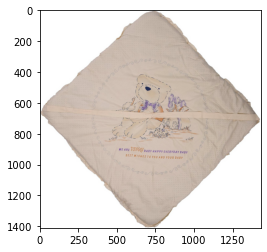

Home Furnishing 


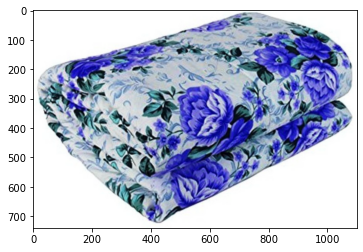

Home Furnishing 


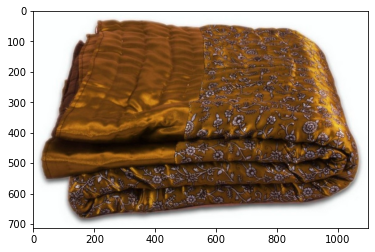

Home Furnishing 


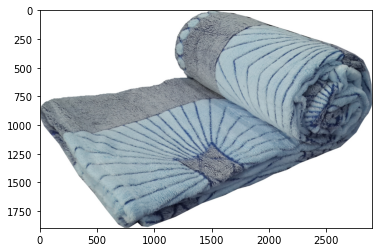

Home Furnishing 


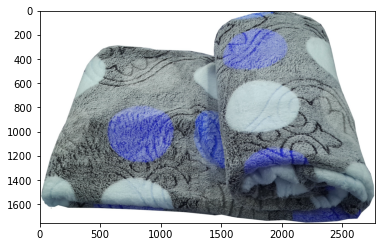

Home Furnishing 


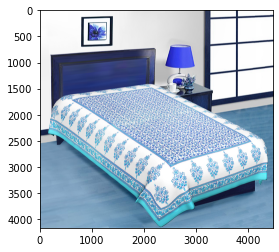

Home Furnishing 


In [527]:
err = df_tsne50[(df_tsne50["class"] == 'Home Furnishing ') & (df_tsne50["kmeans_tsne50"] == 1)].index
for i in err:
  img = cv2.imread(df_tsne50.iloc[i]['image_chemin'])
  plt.imshow(img)
  plt.show()
  print(df_tsne50.iloc[i]['class'])